In [10]:
import argparse
import os
import random
import shutil
import time
import logging
import warnings

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.distributed as dist
import torch.optim
import torch.multiprocessing as mp
import torch.utils.data
import torch.utils.data.distributed
import torchvision
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models


import os
import bioimage

# from interactive_m2unet import M2UnetInteractiveModel
import numpy as np
import imageio
import albumentations as A
from skimage.filters import threshold_otsu
from skimage.measure import label
# Uncomment to specify the gpu number
# os.environ['CUDA_VISIBLE_DEVICES'] = "1"
import torch
torch.backends.cudnn.benchmark = True
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils


In [95]:
import torch
import torchvision
from glob import glob
import torch.nn as nn

from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torchvision.transforms as transform
from torch.utils.data import DataLoader,Dataset
from torchvision.utils import make_grid
import math

from bit_config import *
from utils import *
from pytorchcv.model_provider import get_model as ptcv_get_model

In [99]:
model1 = ptcv_get_model("mobilenetv2_wd2", pretrained = False)
# model1 = ptcv_get_model("resnet18", pretrained = False)


print(model1)

MobileNetV2(
  (features): Sequential(
    (init_block): ConvBlock(
      (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (activ): ReLU6(inplace=True)
    )
    (stage1): Sequential(
      (unit1): LinearBottleneck(
        (conv1): ConvBlock(
          (conv): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (activ): ReLU6(inplace=True)
        )
        (conv2): ConvBlock(
          (conv): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
          (bn): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (activ): ReLU6(inplace=True)
        )
        (conv3): ConvBlock(
          (conv): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1), bias=False)
         

In [65]:
data_dir = './m2unet_quantized/m2unet/cell_data_3' # data should contain a train and a test folder

size = 512
sub_samples = 20

train_dataset = load_samples(data_dir + '/train', size, sub_samples)
test_dataset = load_samples(data_dir + '/test',size, sub_samples)


./m2unet_quantized/m2unet/cell_data_3/train/0_6_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/5_9_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/2_3_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/0_9_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/1_4_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/6_4_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/0_2_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/8_2_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/8_3_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/2_6_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/9_8_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/6_2_f_BF_LED_matrix_dpc_seg.npy
./m2unet_quantized/m2unet/cell_data_3/train/5_7_f_BF_LED_matrix_dpc_seg.npy
./m2unet_qua

In [66]:

parser = argparse.ArgumentParser(description='PyTorch ImageNet Training')
parser.add_argument('--data', metavar='DIR',
                    help='path to dataset')
parser.add_argument('-a', '--arch', metavar='ARCH', default='resnet18',
                    help='model architecture')
parser.add_argument('--teacher-arch',
                    type=str,
                    default='resnet101',
                    help='teacher network used to do distillation')
parser.add_argument('-j', '--workers', default=1, type=int, metavar='N',
                    help='number of data loading workers (default: 4)')
parser.add_argument('--epochs', default=50, type=int, metavar='N',
                    help='number of total epochs to run')
parser.add_argument('--start-epoch', default=0, type=int, metavar='N',
                    help='manual epoch number (useful on restarts)')
parser.add_argument('-b', '--batch-size', default=1, type=int,
                    metavar='N',
                    help='mini-batch size (default: 256), this is the total '
                         'batch size of all GPUs on the current node when '
                         'using Data Parallel or Distributed Data Parallel')
parser.add_argument('--lr', '--learning-rate', default=0.001, type=float,
                    metavar='LR', help='initial learning rate', dest='lr')
parser.add_argument('--momentum', default=0.9, type=float, metavar='M',
                    help='momentum')
parser.add_argument('--wd', '--weight-decay', default=1e-4, type=float,
                    metavar='W', help='weight decay (default: 1e-4)',
                    dest='weight_decay')
parser.add_argument('-p', '--print-freq', default=10, type=int,
                    metavar='N', help='print frequency (default: 10)')
parser.add_argument('--resume', default='', type=str, metavar='PATH',
                    help='path to latest checkpoint (default: none)')
parser.add_argument('-e', '--evaluate', dest='evaluate', action='store_true',
                    help='evaluate model on validation set')
parser.add_argument('--pretrained', dest='pretrained', action='store_true',
                    help='use pre-trained model')
parser.add_argument('--world-size', default=-1, type=int,
                    help='number of nodes for distributed training')
parser.add_argument('--rank', default=-1, type=int,
                    help='node rank for distributed training')
parser.add_argument('--dist-url', default='tcp://224.66.41.62:23456', type=str,
                    help='url used to set up distributed training')
parser.add_argument('--dist-backend', default='nccl', type=str,
                    help='distributed backend')
parser.add_argument('--seed', default=None, type=int,
                    help='seed for initializing training. ')
parser.add_argument('--gpu', default=0, type=int,
                    help='GPU id to use.')
parser.add_argument('--multiprocessing-distributed', action='store_true',
                    help='Use multi-processing distributed training to launch '
                         'N processes per node, which has N GPUs. This is the '
                         'fastest way to use PyTorch for either single node or '
                         'multi node data parallel training')
parser.add_argument('--act-range-momentum',
                    type=float,
                    default=-1,
                    help='momentum of the activation range moving average, '
                         '-1 stands for using minimum of min and maximum of max')
parser.add_argument('--quant-mode',
                    type=str,
                    default='symmetric',
                    choices=['asymmetric', 'symmetric'],
                    help='quantization mode')
parser.add_argument('--save-path',
                    type=str,
                    default='./m2unet_checkpoints/',
                    help='path to save the quantized model')
parser.add_argument('--data-percentage',
                    type=float,
                    default=1,
                    help='data percentage of training data')
parser.add_argument('--fix-BN',
                    action='store_true',
                    help='whether to fix BN statistics and fold BN during training')
parser.add_argument('--fix-BN-threshold',
                    type=int,
                    default=None,
                    help='when to start training with fixed and folded BN,'
                         'after the threshold iteration, the original fix-BN will be overwritten to be True')
parser.add_argument('--checkpoint-iter',
                    type=int,
                    default=-1,
                    help='the iteration that we save all the featuremap for analysis')
parser.add_argument('--evaluate-times',
                    type=int,
                    default=-1,
                    help='The number of evaluations during one epoch')
parser.add_argument('--quant-scheme',
                    type=str,
                    default='uniform8',
                    help='quantization bit configuration')
parser.add_argument('--resume-quantize',
                    action='store_true',
                    help='if True map the checkpoint to a quantized model,'
                         'otherwise map the checkpoint to an ordinary model and then quantize')
parser.add_argument('--act-percentile',
                    type=float,
                    default=0,
                    help='the percentage used for activation percentile'
                         '(0 means no percentile, 99.9 means cut off 0.1%)')
parser.add_argument('--weight-percentile',
                    type=float,
                    default=0,
                    help='the percentage used for weight percentile'
                         '(0 means no percentile, 99.9 means cut off 0.1%)')
parser.add_argument('--channel-wise',
                    action='store_false',
                    help='whether to use channel-wise quantizaiton or not')
parser.add_argument('--bias-bit',
                    type=int,
                    default=32,
                    help='quantizaiton bit-width for bias')
parser.add_argument('--distill-method',
                    type=str,
                    default='None',
                    help='you can choose None or KD_naive')
parser.add_argument('--distill-alpha',
                    type=float,
                    default=0.95,
                    help='how large is the ratio of normal loss and teacher loss')
parser.add_argument('--temperature',
                    type=float,
                    default=6,
                    help='how large is the temperature factor for distillation')
parser.add_argument('--fixed-point-quantization',
                    action='store_true',
                    help='whether to skip deployment-oriented operations and '
                         'use fixed-point rather than integer-only quantization')


_StoreTrueAction(option_strings=['--fixed-point-quantization'], dest='fixed_point_quantization', nargs=0, const=True, default=False, type=None, choices=None, help='whether to skip deployment-oriented operations and use fixed-point rather than integer-only quantization', metavar=None)

In [67]:
def load_samples(train_dir, size, sub_samples):
    
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    sz = size
    transform = A.Compose(
    [
        A.RandomCrop(sz, sz),
        #A.Rotate(limit=[-5, 5], p=1),
        # A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        A.Flip(p=0.5),
        #A.CenterCrop(sz, sz),
    ])
    
    # data_transform = transforms.Compose([
    #     transforms.RandomResizedCrop(sz),
    #     transforms.ToTensor(),
    # ])
    
    
    npy_files = [os.path.join(train_dir, s) for s in os.listdir(train_dir) if s.endswith('.npy')]
    samples = []
    for file in npy_files:
        print(file)
        try:
            items = np.load(file, allow_pickle=True).item()
        except:
            print("Bad Item")
            continue
        
        
        mask = (items['masks'][:, :, None]  > 0) * 1.0
        outline = (items['outlines'][:, :, None]  > 0) * 1.0
        mask = mask * (1.0 - outline)
        # sample = (items['img'], mask)
        # sample_transform = transform(image = items['img'])
        # label_transform = transform(image  = mask)
        
        for i in range(sub_samples):
            transformed = transform(image=items['img'], mask= mask)
            transformed_image = transformed['image']
            transformed_mask = transformed['mask']

            transformed_image = np.swapaxes(transformed_image, 0, 2)
            transformed_mask = np.swapaxes(transformed_mask, 0, 2)
            
            transformed_image = torch.tensor(transformed_image)
            transformed_mask = torch.tensor(transformed_mask)

            
            image = transformed_image.float().to('cpu')
            image = image / 256 # pushing data between 0 and 1
            label = transformed_mask.float().to('cpu')

            sample = (image, label)

            samples.append(sample)

        
        # sample_transform = data_transform(items['img'])
        # label_transform = data_transform(mask)
        
        
    return samples



In [68]:
import torch
import torch.nn as nn
import math

def conv_bn(inp, oup, stride):
    return nn.Sequential(
        nn.Conv2d(inp, oup, 3, stride, 1, bias=False),
        nn.BatchNorm2d(oup),
        nn.ReLU6(inplace=True)
    )


def conv_1x1_bn(inp, oup):
    return nn.Sequential(
        nn.Conv2d(inp, oup, 1, 1, 0, bias=False),
        nn.BatchNorm2d(oup),
        nn.ReLU6(inplace=True)
    )

class InvertedResidual(nn.Module):
    def __init__(self, inp, oup, stride, expand_ratio):
        super(InvertedResidual, self).__init__()
        self.stride = stride
        assert stride in [1, 2]

        hidden_dim = round(inp * expand_ratio)
        self.use_res_connect = self.stride == 1 and inp == oup

        if expand_ratio == 1:
            # depthwise separable convolution block
            self.conv = nn.Sequential(
                # dw
                nn.Conv2d(hidden_dim, hidden_dim, 3, stride, 1, groups=hidden_dim, bias=False),
                nn.BatchNorm2d(hidden_dim),
                nn.ReLU6(inplace=True),
                # pw-linear
                nn.Conv2d(hidden_dim, oup, 1, 1, 0, bias=False),
                nn.BatchNorm2d(oup),
            )
        else:
            # Bottleneck with expansion layer
            self.conv = nn.Sequential(
                # pw
                nn.Conv2d(inp, hidden_dim, 1, 1, 0, bias=False),
                nn.BatchNorm2d(hidden_dim),
                nn.ReLU6(inplace=True),
                # dw
                nn.Conv2d(hidden_dim, hidden_dim, 3, stride, 1, groups=hidden_dim, bias=False),
                nn.BatchNorm2d(hidden_dim),
                nn.ReLU6(inplace=True),
                # pw-linear
                nn.Conv2d(hidden_dim, oup, 1, 1, 0, bias=False),
                nn.BatchNorm2d(oup),
            )

    def forward(self, x):
        if self.use_res_connect:
            return x + self.conv(x)
        else:
            return self.conv(x)
        
class Encoder(nn.Module):
    """
    14 layers of MobileNetv2 as encoder part
    """
    def __init__(self):
        super(Encoder, self).__init__()
        block = InvertedResidual
        interverted_residual_setting = [
            # t, c, n, s
            [1, 16, 1, 1],
            [6, 24, 2, 2],
            [6, 32, 3, 2],
            [6, 64, 4, 2],
            [6, 96, 3, 1],
        ]
        # Encoder Part
        input_channel = 32 # number of input channels to first inverted (residual) block
        self.layers = [conv_bn(3, 32, 2)]
        # building inverted residual blocks
        for t, c, n, s in interverted_residual_setting:
            output_channel = c
            for i in range(n):
                if i == 0:
                    self.layers.append(block(input_channel, output_channel, s, expand_ratio=t))
                else:
                    self.layers.append(block(input_channel, output_channel, 1, expand_ratio=t))
                input_channel = output_channel
        # make it nn.Sequential
        self.layers = nn.Sequential(*self.layers)
                
class DecoderBlock(nn.Module):
    """
    Decoder block: upsample and concatenate with features maps from the encoder part
    """
    def __init__(self,up_in_c,x_in_c,upsamplemode='bilinear',expand_ratio=0.15):
        super().__init__()
        self.upsample = nn.Upsample(scale_factor=2,mode=upsamplemode,align_corners=False) # H, W -> 2H, 2W
        self.ir1 = InvertedResidual(up_in_c+x_in_c,(x_in_c + up_in_c) // 2,stride=1,expand_ratio=expand_ratio)

    def forward(self,up_in,x_in):
        up_out = self.upsample(up_in)
        cat_x = torch.cat([up_out, x_in] , dim=1)
        x = self.ir1(cat_x)
        return x
    
class LastDecoderBlock(nn.Module):
    def __init__(self,x_in_c,upsamplemode='bilinear',expand_ratio=0.15, output_channels=1, activation='linear'):
        super().__init__()
        self.upsample = nn.Upsample(scale_factor=2,mode=upsamplemode,align_corners=False) # H, W -> 2H, 2W
        self.ir1 = InvertedResidual(x_in_c,16,stride=1,expand_ratio=expand_ratio)
        layers =  [
            nn.Conv2d(16, output_channels, 1, 1, 0, bias=True),
        ]
        if activation == 'sigmoid':
            layers.append(nn.Sigmoid())
        elif activation == 'softmax':
            layers.append(nn.Softmax(dim=1))
        elif activation == 'linear' or activation is None:
            pass
        else:
            raise NotImplementedError('Activation {} not implemented'.format(activation))
        self.conv = nn.Sequential(
           *layers
        )

    def forward(self,up_in,x_in):
        up_out = self.upsample(up_in)
        cat_x = torch.cat([up_out, x_in] , dim=1)
        x = self.ir1(cat_x)
        x = self.conv(x)
        return x
    
class M2UNet(nn.Module):
        def __init__(self,encoder,upsamplemode='bilinear',output_channels=1, activation="linear", expand_ratio=0.15):
            super(M2UNet,self).__init__()
            encoder = list(encoder.children())[0]
            # Encoder
            self.conv1 = encoder[0:2]
            self.conv2 = encoder[2:4]
            self.conv3 = encoder[4:7]
            self.conv4 = encoder[7:14]
            # Decoder
            self.decode4 = DecoderBlock(96,32,upsamplemode,expand_ratio)
            self.decode3 = DecoderBlock(64,24,upsamplemode,expand_ratio)
            self.decode2 = DecoderBlock(44,16,upsamplemode,expand_ratio)
            self.decode1 = LastDecoderBlock(33,upsamplemode,expand_ratio, output_channels=output_channels, activation=activation)
            # initilaize weights 
            self._init_params()

        def _init_params(self):
            for m in self.modules():
                if isinstance(m, nn.Conv2d):
                    n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                    m.weight.data.normal_(0, math.sqrt(2. / n))
                    if m.bias is not None:
                        m.bias.data.zero_()
                elif isinstance(m, nn.BatchNorm2d):
                    m.weight.data.fill_(1)
                    m.bias.data.zero_()
                elif isinstance(m, nn.Linear):
                    n = m.weight.size(1)
                    m.weight.data.normal_(0, 0.01)
                    m.bias.data.zero_()
            
        
        
        def forward(self,x):
            conv1 = self.conv1(x)
            conv2 = self.conv2(conv1)
            conv3 = self.conv3(conv2)
            conv4 = self.conv4(conv3)
            decode4 = self.decode4(conv4,conv3)
            decode3 = self.decode3(decode4,conv2)
            decode2 = self.decode2(decode3,conv1)
            decode1 = self.decode1(decode2,x)
            return decode1
        
def m2unet(output_channels=1,expand_ratio=0.15, activation="linear", **kwargs):
    encoder = Encoder()
    model = M2UNet(encoder,upsamplemode='bilinear',expand_ratio=expand_ratio, output_channels=output_channels, activation=activation)
    return model

In [69]:
# initializing the model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
unet = m2unet().float().to(device)



cuda:0


In [110]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
model2 = m2unet().float().to(device)
inp = torch.randn([1, 3, 512, 512]).to(device)
output = model2(inp)
print(output.shape)
target = torch.randn([1, 1, 512, 512]).to(device)

criterion = nn.MSELoss().cuda('0')

loss = criterion(output,target)

loss.backward()




#  output = model(images)
        
# # print('model output')
# # print(output)
# # print('model target')
# # print(target)

# loss = criterion(output, target)
# # print('loss')
# # print(loss)

# # measure accuracy and record loss
# acc1, acc5 = accuracy(output, target, topk=(1,5))
# losses.update(loss.item(), images.size(0))
# top1.update(acc1[0], images.size(0))
# top5.update(acc5[0], images.size(0))

# # compute gradient and do SGD step
# optimizer.zero_grad()
# loss.backward()
# optimizer.step()

cuda:0
torch.Size([1, 1, 512, 512])


In [70]:
args =parser.parse_args("")
all_defaults = {}
for key in vars(args):
    all_defaults[key] = parser.get_default(key)
all_defaults

{'data': None,
 'arch': 'resnet18',
 'teacher_arch': 'resnet101',
 'workers': 1,
 'epochs': 50,
 'start_epoch': 0,
 'batch_size': 1,
 'lr': 0.001,
 'momentum': 0.9,
 'weight_decay': 0.0001,
 'print_freq': 10,
 'resume': '',
 'evaluate': False,
 'pretrained': False,
 'world_size': -1,
 'rank': -1,
 'dist_url': 'tcp://224.66.41.62:23456',
 'dist_backend': 'nccl',
 'seed': None,
 'gpu': 0,
 'multiprocessing_distributed': False,
 'act_range_momentum': -1,
 'quant_mode': 'symmetric',
 'save_path': './m2unet_checkpoints/',
 'data_percentage': 1,
 'fix_BN': False,
 'fix_BN_threshold': None,
 'checkpoint_iter': -1,
 'evaluate_times': -1,
 'quant_scheme': 'uniform8',
 'resume_quantize': False,
 'act_percentile': 0,
 'weight_percentile': 0,
 'channel_wise': True,
 'bias_bit': 32,
 'distill_method': 'None',
 'distill_alpha': 0.95,
 'temperature': 6,
 'fixed_point_quantization': False}

In [71]:
args = parser.parse_args("")
if not os.path.exists(args.save_path):
    os.makedirs(args.save_path)
    
print(os.path.exists(args.save_path))

hook_counter = args.checkpoint_iter
hook_keys = []
hook_keys_counter = 0

logging.basicConfig(format='%(asctime)s - %(message)s',
                    datefmt='%d-%b-%y %H:%M:%S', filename=args.save_path + 'log.log')
logging.getLogger().setLevel(logging.INFO)
logging.getLogger().addHandler(logging.StreamHandler())

logging.info(args)

Namespace(act_percentile=0, act_range_momentum=-1, arch='resnet18', batch_size=1, bias_bit=32, channel_wise=True, checkpoint_iter=-1, data=None, data_percentage=1, dist_backend='nccl', dist_url='tcp://224.66.41.62:23456', distill_alpha=0.95, distill_method='None', epochs=50, evaluate=False, evaluate_times=-1, fix_BN=False, fix_BN_threshold=None, fixed_point_quantization=False, gpu=0, lr=0.001, momentum=0.9, multiprocessing_distributed=False, pretrained=False, print_freq=10, quant_mode='symmetric', quant_scheme='uniform8', rank=-1, resume='', resume_quantize=False, save_path='./m2unet_checkpoints/', seed=None, start_epoch=0, teacher_arch='resnet101', temperature=6, weight_decay=0.0001, weight_percentile=0, workers=1, world_size=-1)
Namespace(act_percentile=0, act_range_momentum=-1, arch='resnet18', batch_size=1, bias_bit=32, channel_wise=True, checkpoint_iter=-1, data=None, data_percentage=1, dist_backend='nccl', dist_url='tcp://224.66.41.62:23456', distill_alpha=0.95, distill_method='N

True


In [72]:
best_acc1 = 0
def train(train_loader, model, criterion, optimizer, epoch, args):
    batch_time = AverageMeter('Time', ':6.3f')
    data_time = AverageMeter('Data', ':6.3f')
    losses = AverageMeter('Loss', ':.4e')
    top1 = AverageMeter('Acc@1', ':6.2f')
    top5 = AverageMeter('Acc@5', ':6.2f')
    progress = ProgressMeter(
        len(train_loader),
        [batch_time, data_time, losses, top1, top5],
        prefix="Epoch: [{}]".format(epoch))

    # switch to train mode
    if args.fix_BN == True:
        model.eval()
    else:
        model.train()

    end = time.time()
    for i, (images, target) in enumerate(train_loader):
        # measure data loading time
        data_time.update(time.time() - end)

        if args.gpu is not None:
            images = images.cuda(args.gpu, non_blocking=True)
        target = target.cuda(args.gpu, non_blocking=True)

        # compute output
        # print('model input')
        # print(images)
        
        output = model(images)
        
        # print('model output')
        # print(output)
        # print('model target')
        # print(target)
        
        loss = criterion(output, target)
        # print('loss')
        # print(loss)

        # measure accuracy and record loss
        acc1, acc5 = accuracy(output, target, topk=(1,5))
        losses.update(loss.item(), images.size(0))
        top1.update(acc1[0], images.size(0))
        top5.update(acc5[0], images.size(0))

        # compute gradient and do SGD step
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if i % args.print_freq == 0:
            progress.display(i)


def train_kd(train_loader, model, teacher, criterion, optimizer, epoch, val_loader, args, ngpus_per_node,
             dataset_length):
    batch_time = AverageMeter('Time', ':6.3f')
    data_time = AverageMeter('Data', ':6.3f')
    losses = AverageMeter('Loss', ':.4e')
    top1 = AverageMeter('Acc@1', ':6.2f')
    top5 = AverageMeter('Acc@5', ':6.2f')
    progress = ProgressMeter(
        len(train_loader),
        [batch_time, data_time, losses, top1, top5],
        prefix="Epoch: [{}]".format(epoch))

    # switch to train mode
    if args.fix_BN == True:
        model.eval()
    else:
        model.train()
    teacher.eval()

    end = time.time()

    for i, (images, target) in enumerate(train_loader):
        # measure data loading time
        data_time.update(time.time() - end)

        if args.gpu is not None:
            images = images.cuda(args.gpu, non_blocking=True)
        target = target.cuda(args.gpu, non_blocking=True)

        # compute output
        output = model(images)
        if args.distill_method != 'None':
            with torch.no_grad():
                teacher_output = teacher(images)

        if args.distill_method == 'None':
            loss = criterion(output, target)
        elif args.distill_method == 'KD_naive':
            loss = loss_kd(output, target, teacher_output, args)
        else:
            raise NotImplementedError

        # measure accuracy and record loss
        acc1, acc5 = accuracy(output, target, topk=(1, 5))
        losses.update(loss.item(), images.size(0))
        top1.update(acc1[0], images.size(0))
        top5.update(acc5[0], images.size(0))

        # compute gradient and do SGD step
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if i % args.print_freq == 0:
            progress.display(i)
        if i % args.print_freq == 0 and args.rank == 0:
            print('Epoch {epoch_} [{iters}]  Acc@1 {top1.avg:.3f} Acc@5 {top5.avg:.3f}'.format(epoch_=epoch, iters=i,
                                                                                               top1=top1, top5=top5))

        if i % ((dataset_length // (
                args.batch_size * args.evaluate_times)) + 2) == 0 and i > 0 and args.evaluate_times > 0:
            acc1 = validate(val_loader, model, criterion, args)

            # switch to train mode
            if args.fix_BN == True:
                model.eval()
            else:
                model.train()

            # remember best acc@1 and save checkpoint
            global best_acc1
            is_best = acc1 > best_acc1
            best_acc1 = max(acc1, best_acc1)

            if not args.multiprocessing_distributed or (args.multiprocessing_distributed
                                                        and args.rank % ngpus_per_node == 0):
                if not os.path.exists(args.save_path):
                    os.makedirs(args.save_path)

                save_checkpoint({
                    'epoch': epoch + 1,
                    'arch': args.arch,
                    'state_dict': model.state_dict(),
                    'best_acc1': best_acc1,
                    'optimizer': optimizer.state_dict(),
                }, is_best, args.save_path)


def validate(val_loader, model, criterion, args):
    batch_time = AverageMeter('Time', ':6.3f')
    losses = AverageMeter('Loss', ':.4e')
    top1 = AverageMeter('Acc@1', ':6.2f')
    top5 = AverageMeter('Acc@5', ':6.2f')
    progress = ProgressMeter(
        len(val_loader),
        [batch_time, losses, top1, top5],
        prefix='Test: ')

    # switch to evaluate mode
    freeze_model(model)
    model.eval()

    with torch.no_grad():
        end = time.time()
        for i, (images, target) in enumerate(val_loader):
            if args.gpu is not None:
                images = images.cuda(args.gpu, non_blocking=True)
            target = target.cuda(args.gpu, non_blocking=True)

            # compute output
            output = model(images)
            loss = criterion(output, target)

            # measure accuracy and record loss
            acc1, acc5 = accuracy(output, target, topk=(1, 5))
            losses.update(loss.item(), images.size(0))
            top1.update(acc1[0], images.size(0))
            top5.update(acc5[0], images.size(0))

            # measure elapsed time
            batch_time.update(time.time() - end)
            end = time.time()

            if i % args.print_freq == 0:
                progress.display(i)

        logging.info(' * Acc@1 {top1.avg:.3f} Acc@5 {top5.avg:.3f}'.format(top1=top1, top5=top5))

    torch.save({'convbn_scaling_factor': {k: v for k, v in model.state_dict().items() if 'convbn_scaling_factor' in k},
                'fc_scaling_factor': {k: v for k, v in model.state_dict().items() if 'fc_scaling_factor' in k},
                'weight_integer': {k: v for k, v in model.state_dict().items() if 'weight_integer' in k},
                'bias_integer': {k: v for k, v in model.state_dict().items() if 'bias_integer' in k},
                'act_scaling_factor': {k: v for k, v in model.state_dict().items() if 'act_scaling_factor' in k},
                }, args.save_path + 'quantized_checkpoint.pth.tar')

    unfreeze_model(model)

    return top1.avg


def save_checkpoint(state, is_best, filename=None):
    torch.save(state, filename + 'checkpoint.pth.tar')
    if is_best:
        shutil.copyfile(filename + 'checkpoint.pth.tar', filename + 'model_best.pth.tar')


class AverageMeter(object):
    """Computes and stores the average and current value"""

    def __init__(self, name, fmt=':f'):
        self.name = name
        self.fmt = fmt
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

    def __str__(self):
        fmtstr = '{name} {val' + self.fmt + '} ({avg' + self.fmt + '})'
        return fmtstr.format(**self.__dict__)


class ProgressMeter(object):
    def __init__(self, num_batches, meters, prefix=""):
        self.batch_fmtstr = self._get_batch_fmtstr(num_batches)
        self.meters = meters
        self.prefix = prefix

    def display(self, batch):
        entries = [self.prefix + self.batch_fmtstr.format(batch)]
        entries += [str(meter) for meter in self.meters]
        logging.info('\t'.join(entries))

    def _get_batch_fmtstr(self, num_batches):
        num_digits = len(str(num_batches // 1))
        fmt = '{:' + str(num_digits) + 'd}'
        return '[' + fmt + '/' + fmt.format(num_batches) + ']'


def adjust_learning_rate(optimizer, epoch, args):
    """Sets the learning rate to the initial LR decayed by 10 every 30 epochs"""
    lr = args.lr * (0.1 ** (epoch // 30))
    print('lr = ', lr)
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr


# def accuracy(output, target, topk=(1,)):
#     """Computes the accuracy over the k top predictions for the specified values of k"""
#     with torch.no_grad():
        
     
#         maxk = max(topk)
#         batch_size = target.size(0)

#         _, pred = output.topk(maxk, 1, True, True)
#         pred = pred.t()
#         correct = pred.eq(target.view(1, -1).expand_as(pred))

#         res = []
        
#         for k in topk:
#             correct_k = correct[:k].reshape(-1).float().sum(0, keepdim=True)
#             res.append(correct_k.mul_(100.0 / batch_size))
#         return res

def accuracy(output, target, topk=(1,)):
    """Computes the accuracy over the k top predictions for the specified values of k"""
    with torch.no_grad():
        
        
        threshold = threshold_otsu(output.cpu().detach().numpy())
        output = (output > threshold) * 1
        
        
        
        res = [];
        j = jaccard_sim(output, target)
        
        res.append(float(j))
        res.append(float(j))

        
        
        return res, res

def jaccard_sim(img1, img2):
    n = img1.shape[-1]**2
    a = img1 * img2
    b = img1 + img2 - a
    J = a/b
    J[torch.isnan(J)] = 1
    j = torch.sum(J)/n

    return j

def loss_kd(output, target, teacher_output, args):
    """
    Compute the knowledge-distillation (KD) loss given outputs and labels.
    "Hyperparameters": temperature and alpha
    The KL Divergence for PyTorch comparing the softmaxs of teacher and student.
    The KL Divergence expects the input tensor to be log probabilities.
    """
    alpha = args.distill_alpha
    T = args.temperature
    KD_loss = F.kl_div(F.log_softmax(output / T, dim=1), F.softmax(teacher_output / T, dim=1)) * (alpha * T * T) + \
              F.cross_entropy(output, target) * (1. - alpha)

    return KD_loss

In [73]:
def main():
    if args.seed is not None:
        random.seed(args.seed)
        torch.manual_seed(args.seed)
        cudnn.deterministic = True
        warnings.warn('You have chosen to seed training. '
                      'This will turn on the CUDNN deterministic setting, '
                      'which can slow down your training considerably! '
                      'You may see unexpected behavior when restarting '
                      'from checkpoints.')

    if args.gpu is not None:
        warnings.warn('You have chosen a specific GPU. This will completely '
                      'disable data parallelism.')

    if args.dist_url == "env://" and args.world_size == -1:
        args.world_size = int(os.environ["WORLD_SIZE"])

    args.distributed = args.world_size > 1 or args.multiprocessing_distributed

    ngpus_per_node = torch.cuda.device_count()
    print('ngpus per node')
    print(ngpus_per_node)
    if args.multiprocessing_distributed:
        # Since we have ngpus_per_node processes per node, the total world_size
        # needs to be adjusted accordingly
        args.world_size = ngpus_per_node * args.world_size
        # Use torch.multiprocessing.spawn to launch distributed processes: the
        # main_worker process function
        mp.spawn(main_worker, nprocs=ngpus_per_node, args=(ngpus_per_node, args))
    else:
        # Simply call main_worker function
        main_worker(args.gpu, ngpus_per_node, args)


def main_worker(gpu, ngpus_per_node, args):
    global best_acc1
    args.gpu = gpu

    if args.gpu is not None:
        logging.info("Use GPU: {} for training".format(args.gpu))

    if args.distributed:
        if args.dist_url == "env://" and args.rank == -1:
            args.rank = int(os.environ["RANK"])
        if args.multiprocessing_distributed:
            # For multiprocessing distributed training, rank needs to be the
            # global rank among all the processes
            args.rank = args.rank * ngpus_per_node + gpu
        dist.init_process_group(backend=args.dist_backend, init_method=args.dist_url,
                                world_size=args.world_size, rank=args.rank)
    # create model
    if args.pretrained and not args.resume:
        logging.info("=> using pre-trained PyTorchCV model '{}'".format(args.arch))
        # model = ptcv_get_model(args.arch, pretrained=True)
        
        model = unet
        
        if args.distill_method != 'None':
            logging.info("=> using pre-trained PyTorchCV teacher '{}'".format(args.teacher_arch))
            teacher = ptcv_get_model(args.teacher_arch, pretrained=True)
            

    else:
        logging.info("=> creating PyTorchCV model '{}'".format(args.arch))
        # model = ptcv_get_model(args.arch, pretrained=False)
        
        model = unet
        
        if args.distill_method != 'None':
            logging.info("=> creating PyTorchCV teacher '{}'".format(args.teacher_arch))
            teacher = ptcv_get_model('unet_cityscapes', pretrained=False)

    if args.resume and not args.resume_quantize:
        if os.path.isfile(args.resume):
            logging.info("=> loading checkpoint '{}'".format(args.resume))

            checkpoint = torch.load(args.resume)['state_dict']
            model_key_list = list(model.state_dict().keys())
            for key in model_key_list:
                if 'num_batches_tracked' in key: model_key_list.remove(key)
            i = 0
            modified_dict = {}
            for key, value in checkpoint.items():
                if 'scaling_factor' in key: continue
                if 'num_batches_tracked' in key: continue
                if 'weight_integer' in key: continue
                if 'min' in key or 'max' in key: continue
                modified_key = model_key_list[i]
                modified_dict[modified_key] = value
                i += 1
            logging.info(model.load_state_dict(modified_dict, strict=False))
        else:
            logging.info("=> no checkpoint found at '{}'".format(args.resume))

    # quantize_arch = quantize_arch_dict[args.arch]

    # model = quantize_arch(model)

    bit_config = bit_config_dict["bit_config_" + args.arch + "_" + args.quant_scheme]
    name_counter = 0

    for name, m in model.named_modules():
        if name in bit_config.keys():
            name_counter += 1
            setattr(m, 'quant_mode', 'symmetric')
            setattr(m, 'bias_bit', args.bias_bit)
            setattr(m, 'quantize_bias', (args.bias_bit != 0))
            setattr(m, 'per_channel', args.channel_wise)
            setattr(m, 'act_percentile', args.act_percentile)
            setattr(m, 'act_range_momentum', args.act_range_momentum)
            setattr(m, 'weight_percentile', args.weight_percentile)
            setattr(m, 'fix_flag', False)
            setattr(m, 'fix_BN', args.fix_BN)
            setattr(m, 'fix_BN_threshold', args.fix_BN_threshold)
            setattr(m, 'training_BN_mode', args.fix_BN)
            setattr(m, 'checkpoint_iter_threshold', args.checkpoint_iter)
            setattr(m, 'save_path', args.save_path)
            setattr(m, 'fixed_point_quantization', args.fixed_point_quantization)

            if type(bit_config[name]) is tuple:
                bitwidth = bit_config[name][0]
                if bit_config[name][1] == 'hook':
                    m.register_forward_hook(hook_fn_forward)
                    global hook_keys
                    hook_keys.append(name)
            else:
                bitwidth = bit_config[name]

            if hasattr(m, 'activation_bit'):
                setattr(m, 'activation_bit', bitwidth)
                if bitwidth == 4:
                    setattr(m, 'quant_mode', 'asymmetric')
            else:
                setattr(m, 'weight_bit', bitwidth)

    logging.info("match all modules defined in bit_config: {}".format(len(bit_config.keys()) == name_counter))
    logging.info(model)

    if args.resume and args.resume_quantize:
        if os.path.isfile(args.resume):
            logging.info("=> loading quantized checkpoint '{}'".format(args.resume))
            checkpoint = torch.load(args.resume)['state_dict']
            modified_dict = {}
            for key, value in checkpoint.items():
                if 'num_batches_tracked' in key: continue
                if 'weight_integer' in key: continue
                if 'bias_integer' in key: continue

                modified_key = key.replace("module.", "")
                modified_dict[modified_key] = value
            model.load_state_dict(modified_dict, strict=False)
        else:
            logging.info("=> no quantized checkpoint found at '{}'".format(args.resume))

    if args.distributed:
        # For multiprocessing distributed, DistributedDataParallel constructor
        # should always set the single device scope, otherwise,
        # DistributedDataParallel will use all available devices.
        if args.gpu is not None:
            torch.cuda.set_device(args.gpu)
            model.cuda(args.gpu)
            # When using a single GPU per process and per
            # DistributedDataParallel, we need to divide the batch size
            # ourselves based on the total number of GPUs we have
            args.batch_size = int(args.batch_size / ngpus_per_node)
            args.workers = int((args.workers + ngpus_per_node - 1) / ngpus_per_node)
            model = torch.nn.parallel.DistributedDataParallel(model, device_ids=[args.gpu])
            if args.distill_method != 'None':
                teacher.cuda(args.gpu)
                teacher = torch.nn.parallel.DistributedDataParallel(teacher, device_ids=[args.gpu])
        else:
            model.cuda()
            # DistributedDataParallel will divide and allocate batch_size to all
            # available GPUs if device_ids are not set
            model = torch.nn.parallel.DistributedDataParallel(model)
            if args.distill_method != 'None':
                teacher.cuda()
                teacher = torch.nn.parallel.DistributedDataParallel(teacher)
    elif args.gpu is not None:
        torch.cuda.set_device(args.gpu)
        model = model.cuda(args.gpu)
        if args.distill_method != 'None':
            teacher = teacher.cuda(args.gpu)
    else:
        # DataParallel will divide and allocate batch_size to all available GPUs
        if args.arch.startswith('alexnet') or args.arch.startswith('vgg'):
            model.features = torch.nn.DataParallel(model.features)
            model.cuda()
            # teacher is not alexnet or vgg
            if args.distill_method != 'None':
                teacher = torch.nn.DataParallel(teacher).cuda()
        else:
            model = torch.nn.DataParallel(model).cuda()
            if args.distill_method != 'None':
                teacher = torch.nn.DataParallel(teacher).cuda()

    # define loss function (criterion) and optimizer
    criterion = nn.MSELoss().cuda(args.gpu)

    optimizer = torch.optim.SGD(model.parameters(), args.lr,
                                momentum=args.momentum,
                                weight_decay=args.weight_decay)

    # optionally resume optimizer and meta information from a checkpoint
    if args.resume:
        if os.path.isfile(args.resume):
            if args.gpu is None:
                checkpoint = torch.load(args.resume)
            else:
                # Map model to be loaded to specified single gpu.
                loc = 'cuda:{}'.format(args.gpu)
                checkpoint = torch.load(args.resume, map_location=loc)
            args.start_epoch = checkpoint['epoch']
            best_acc1 = checkpoint['best_acc1']
            if args.gpu is not None:
                # best_acc1 may be from a checkpoint from a different GPU
                best_acc1 = best_acc1.to(args.gpu)
            optimizer.load_state_dict(checkpoint['optimizer'])
            logging.info("=> loaded optimizer and meta information from checkpoint '{}' (epoch {})".
                         format(args.resume, checkpoint['epoch']))
        else:
            logging.info("=> no checkpoint found at '{}'".format(args.resume))

    cudnn.benchmark = True

#     # Old code
#     # Data loading code
#     traindir = os.path.join(args.data, 'train')
#     valdir = os.path.join(args.data, 'val')
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])

    train_resolution = 224
    if args.arch == "inceptionv3":
        train_resolution = 299

#     train_dataset = datasets.ImageFolder(
#         traindir,
#         transforms.Compose([
#             transforms.RandomResizedCrop(train_resolution),
#             transforms.RandomHorizontalFlip(),
#             transforms.ToTensor(),
#             normalize,
#         ]))


    # New code
    # Transform for Cifar-10
    transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
    
    # Image resolution
    train_resolution = 512
    if args.arch == "inceptionv3":
        train_resolution = 299
    
    
    
    
    # Load data into Dataloader

    # for (images, labels) in enum
    # bs = 4
    # train_dataloader = DataLoader(train_samples, batch_size=bs, shuffle=True)
    # test_dataloader = DataLoader(test_samples, batch_size=1, shuffle=True)

    
    
    
    # train_dataset = torchvision.datasets.CIFAR10(root='./data', train=True,
    #                                     download=True, transform=transform)
    # trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
    #                                       shuffle=True, num_workers=2)


    
    

    if args.distributed:
        train_sampler = torch.utils.data.distributed.DistributedSampler(train_dataset)
    else:
        train_sampler = None

    dataset_length = int(len(train_dataset) * args.data_percentage)
    if args.data_percentage == 1:
        train_loader = torch.utils.data.DataLoader(
            train_dataset, batch_size=args.batch_size, shuffle=(train_sampler is None),
            num_workers=args.workers, pin_memory=True, sampler=train_sampler)
    else:
        partial_train_dataset, _ = torch.utils.data.random_split(train_dataset,
                                                                 [dataset_length, len(train_dataset) - dataset_length])
        train_loader = torch.utils.data.DataLoader(
            partial_train_dataset, batch_size=args.batch_size, shuffle=(train_sampler is None),
            num_workers=args.workers, pin_memory=True, sampler=train_sampler)

    test_resolution = (256, 224)
    if args.arch == 'inceptionv3':
        test_resolution = (342, 299)
        
        

        
    # # Old validation data loader    
    # # evaluate on validation set
    val_loader = torch.utils.data.DataLoader(test_dataset,
        batch_size=args.batch_size, shuffle=False,
        num_workers=args.workers, pin_memory=True)
    
    

    
    

    

    if args.evaluate:
        validate(val_loader, model, criterion, args)
        return

    best_epoch = 0
    for epoch in range(args.start_epoch, args.epochs):
        if args.distributed:
            train_sampler.set_epoch(epoch)
        adjust_learning_rate(optimizer, epoch, args)

        # train for one epoch
        if args.distill_method != 'None':
            train_kd(train_loader, model, teacher, criterion, optimizer, epoch, val_loader,
                     args, ngpus_per_node, dataset_length)
        else:
            train(train_loader, model, criterion, optimizer, epoch, args)

        acc1 = validate(val_loader, model, criterion, args)

        if epoch % 5 == 0:
            c = 0
            for img,label in (val_loader):
                    # img = img.float().to(device)
                    # img = img / 256
                    # print(label)
                    label = label.float().to(device)
                    img = img.to(device)
                    output = model(img)
                    # print(output)
                    show(img,output,label)
                    # acc1, acc5 = accuracy(output, label, topk=(1,5))
                    # print(acc1[0])
                    if c>20:
                        break
                    c+=1
        
        # remember best acc@1 and save checkpoint
        is_best = acc1 > best_acc1
        best_acc1 = max(acc1, best_acc1)

        logging.info(f'Best acc at epoch {epoch}: {best_acc1}')
        if is_best:
            # record the best epoch
            best_epoch = epoch

        if not args.multiprocessing_distributed or (args.multiprocessing_distributed
                                                    and args.rank % ngpus_per_node == 0):
            if not os.path.exists(args.save_path):
                os.makedirs(args.save_path)
            print('save checkpoint')
            save_checkpoint({
                'epoch': epoch + 1,
                'arch': args.arch,
                'state_dict': model.state_dict(),
                'best_acc1': best_acc1,
                'optimizer': optimizer.state_dict(),
            }, is_best, args.save_path)
            


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: You have chosen a specific GPU. This will completely disable data parallelism.
  del sys.path[0]
Use GPU: 0 for training
Use GPU: 0 for training
Use GPU: 0 for training
Use GPU: 0 for training
=> creating PyTorchCV model 'resnet18'
=> creating PyTorchCV model 'resnet18'
=> creating PyTorchCV model 'resnet18'
=> creating PyTorchCV model 'resnet18'
match all modules defined in bit_config: False
match all modules defined in bit_config: False
match all modules defined in bit_config: False
match all modules defined in bit_config: False
M2UNet(
  (conv1): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), p

ngpus per node
1
lr =  0.001


Epoch: [0][   0/1600]	Time  0.157 ( 0.157)	Data  0.079 ( 0.079)	Loss 7.0448e+00 (7.0448e+00)	Acc@1   0.57 (  0.57)	Acc@5   0.57 (  0.57)
Epoch: [0][   0/1600]	Time  0.157 ( 0.157)	Data  0.079 ( 0.079)	Loss 7.0448e+00 (7.0448e+00)	Acc@1   0.57 (  0.57)	Acc@5   0.57 (  0.57)
Epoch: [0][   0/1600]	Time  0.157 ( 0.157)	Data  0.079 ( 0.079)	Loss 7.0448e+00 (7.0448e+00)	Acc@1   0.57 (  0.57)	Acc@5   0.57 (  0.57)
Epoch: [0][   0/1600]	Time  0.157 ( 0.157)	Data  0.079 ( 0.079)	Loss 7.0448e+00 (7.0448e+00)	Acc@1   0.57 (  0.57)	Acc@5   0.57 (  0.57)
Epoch: [0][  10/1600]	Time  0.037 ( 0.050)	Data  0.000 ( 0.008)	Loss 5.9175e-01 (1.5985e+00)	Acc@1   0.55 (  0.47)	Acc@5   0.55 (  0.47)
Epoch: [0][  10/1600]	Time  0.037 ( 0.050)	Data  0.000 ( 0.008)	Loss 5.9175e-01 (1.5985e+00)	Acc@1   0.55 (  0.47)	Acc@5   0.55 (  0.47)
Epoch: [0][  10/1600]	Time  0.037 ( 0.050)	Data  0.000 ( 0.008)	Loss 5.9175e-01 (1.5985e+00)	Acc@1   0.55 (  0.47)	Acc@5   0.55 (  0.47)
Epoch: [0][  10/1600]	Time  0.037 ( 0.050

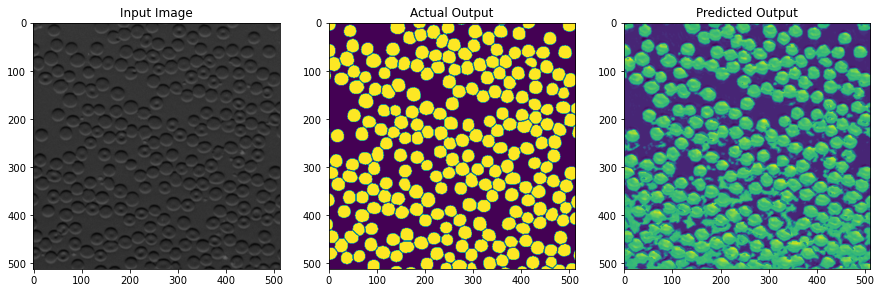

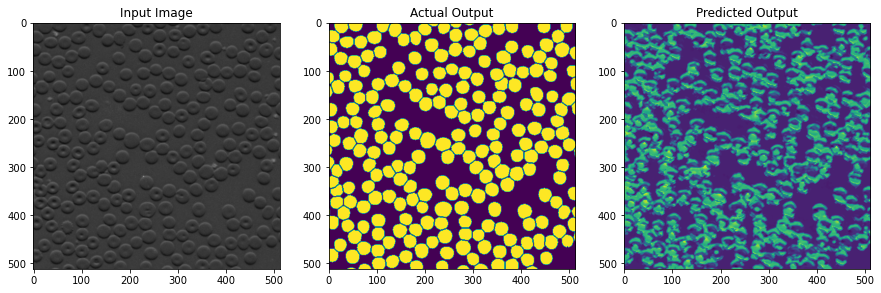

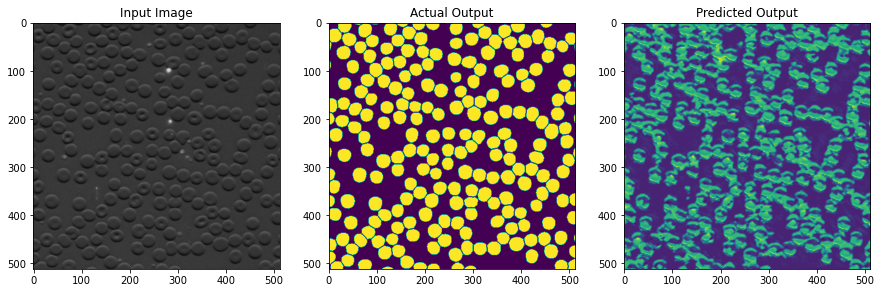

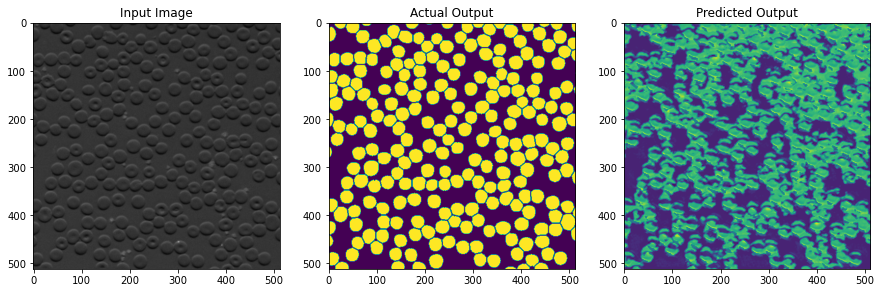

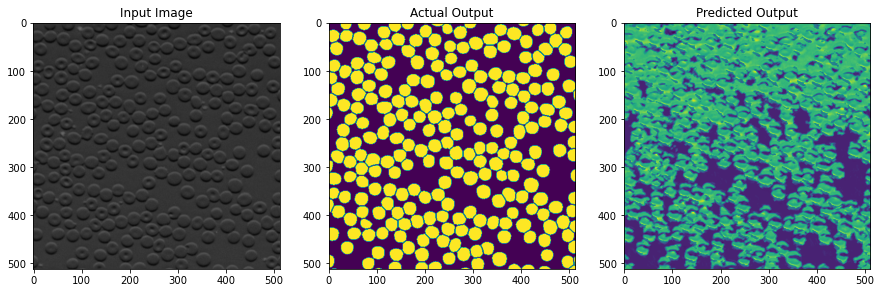

...

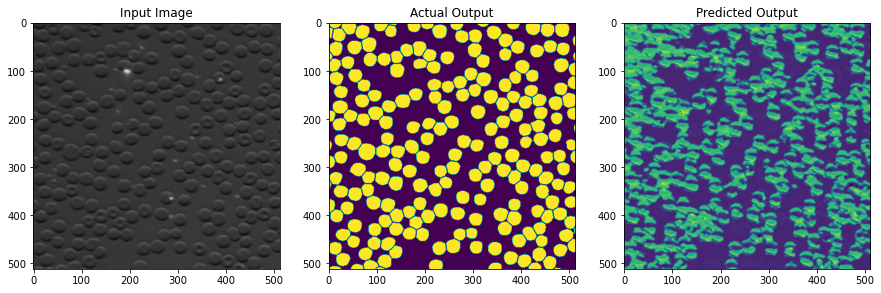

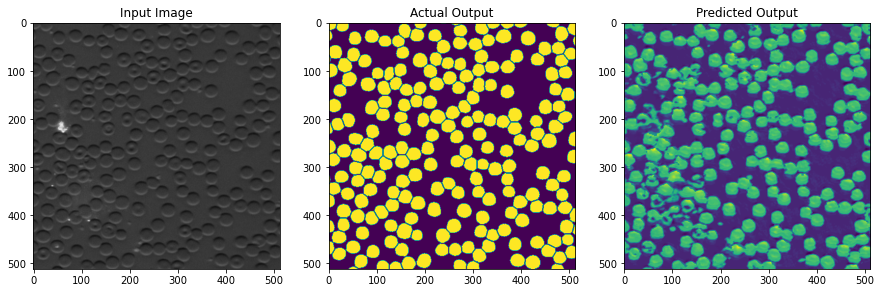

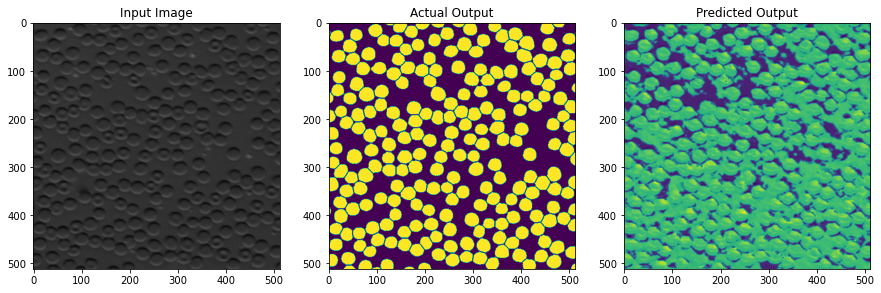

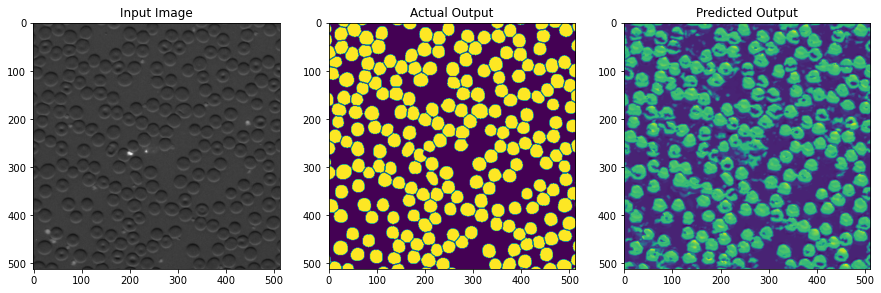

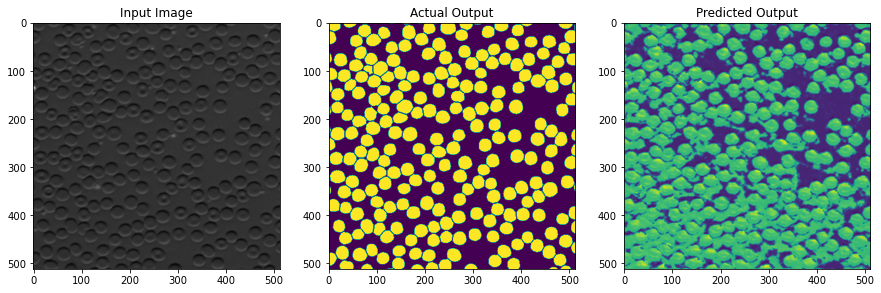

Best acc at epoch 0: 0.7882594871520996
Best acc at epoch 0: 0.7882594871520996
Best acc at epoch 0: 0.7882594871520996
Best acc at epoch 0: 0.7882594871520996


save checkpoint
lr =  0.001


Epoch: [1][   0/1600]	Time  0.154 ( 0.154)	Data  0.086 ( 0.086)	Loss 7.2582e-02 (7.2582e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [1][   0/1600]	Time  0.154 ( 0.154)	Data  0.086 ( 0.086)	Loss 7.2582e-02 (7.2582e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [1][   0/1600]	Time  0.154 ( 0.154)	Data  0.086 ( 0.086)	Loss 7.2582e-02 (7.2582e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [1][   0/1600]	Time  0.154 ( 0.154)	Data  0.086 ( 0.086)	Loss 7.2582e-02 (7.2582e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [1][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.008)	Loss 7.2911e-02 (8.5133e-02)	Acc@1   0.91 (  0.89)	Acc@5   0.91 (  0.89)
Epoch: [1][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.008)	Loss 7.2911e-02 (8.5133e-02)	Acc@1   0.91 (  0.89)	Acc@5   0.91 (  0.89)
Epoch: [1][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.008)	Loss 7.2911e-02 (8.5133e-02)	Acc@1   0.91 (  0.89)	Acc@5   0.91 (  0.89)
Epoch: [1][  10/1600]	Time  0.038 ( 0.052

save checkpoint
lr =  0.001


Epoch: [2][   0/1600]	Time  0.154 ( 0.154)	Data  0.083 ( 0.083)	Loss 8.9337e-02 (8.9337e-02)	Acc@1   0.89 (  0.89)	Acc@5   0.89 (  0.89)
Epoch: [2][   0/1600]	Time  0.154 ( 0.154)	Data  0.083 ( 0.083)	Loss 8.9337e-02 (8.9337e-02)	Acc@1   0.89 (  0.89)	Acc@5   0.89 (  0.89)
Epoch: [2][   0/1600]	Time  0.154 ( 0.154)	Data  0.083 ( 0.083)	Loss 8.9337e-02 (8.9337e-02)	Acc@1   0.89 (  0.89)	Acc@5   0.89 (  0.89)
Epoch: [2][   0/1600]	Time  0.154 ( 0.154)	Data  0.083 ( 0.083)	Loss 8.9337e-02 (8.9337e-02)	Acc@1   0.89 (  0.89)	Acc@5   0.89 (  0.89)
Epoch: [2][  10/1600]	Time  0.038 ( 0.050)	Data  0.000 ( 0.008)	Loss 4.2541e-02 (6.0092e-02)	Acc@1   0.95 (  0.93)	Acc@5   0.95 (  0.93)
Epoch: [2][  10/1600]	Time  0.038 ( 0.050)	Data  0.000 ( 0.008)	Loss 4.2541e-02 (6.0092e-02)	Acc@1   0.95 (  0.93)	Acc@5   0.95 (  0.93)
Epoch: [2][  10/1600]	Time  0.038 ( 0.050)	Data  0.000 ( 0.008)	Loss 4.2541e-02 (6.0092e-02)	Acc@1   0.95 (  0.93)	Acc@5   0.95 (  0.93)
Epoch: [2][  10/1600]	Time  0.038 ( 0.050

save checkpoint
lr =  0.001


Epoch: [3][   0/1600]	Time  0.175 ( 0.175)	Data  0.094 ( 0.094)	Loss 3.8461e-02 (3.8461e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [3][   0/1600]	Time  0.175 ( 0.175)	Data  0.094 ( 0.094)	Loss 3.8461e-02 (3.8461e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [3][   0/1600]	Time  0.175 ( 0.175)	Data  0.094 ( 0.094)	Loss 3.8461e-02 (3.8461e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [3][   0/1600]	Time  0.175 ( 0.175)	Data  0.094 ( 0.094)	Loss 3.8461e-02 (3.8461e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [3][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.009)	Loss 5.4034e-02 (5.6549e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [3][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.009)	Loss 5.4034e-02 (5.6549e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [3][  10/1600]	Time  0.038 ( 0.052)	Data  0.000 ( 0.009)	Loss 5.4034e-02 (5.6549e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [3][  10/1600]	Time  0.038 ( 0.052

save checkpoint
lr =  0.001


Epoch: [4][   0/1600]	Time  0.172 ( 0.172)	Data  0.088 ( 0.088)	Loss 6.0314e-02 (6.0314e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [4][   0/1600]	Time  0.172 ( 0.172)	Data  0.088 ( 0.088)	Loss 6.0314e-02 (6.0314e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [4][   0/1600]	Time  0.172 ( 0.172)	Data  0.088 ( 0.088)	Loss 6.0314e-02 (6.0314e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [4][   0/1600]	Time  0.172 ( 0.172)	Data  0.088 ( 0.088)	Loss 6.0314e-02 (6.0314e-02)	Acc@1   0.92 (  0.92)	Acc@5   0.92 (  0.92)
Epoch: [4][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.008)	Loss 6.7750e-02 (4.6787e-02)	Acc@1   0.92 (  0.94)	Acc@5   0.92 (  0.94)
Epoch: [4][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.008)	Loss 6.7750e-02 (4.6787e-02)	Acc@1   0.92 (  0.94)	Acc@5   0.92 (  0.94)
Epoch: [4][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.008)	Loss 6.7750e-02 (4.6787e-02)	Acc@1   0.92 (  0.94)	Acc@5   0.92 (  0.94)
Epoch: [4][  10/1600]	Time  0.038 ( 0.051

save checkpoint
lr =  0.001


Epoch: [5][   0/1600]	Time  0.162 ( 0.162)	Data  0.098 ( 0.098)	Loss 4.9678e-02 (4.9678e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [5][   0/1600]	Time  0.162 ( 0.162)	Data  0.098 ( 0.098)	Loss 4.9678e-02 (4.9678e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [5][   0/1600]	Time  0.162 ( 0.162)	Data  0.098 ( 0.098)	Loss 4.9678e-02 (4.9678e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [5][   0/1600]	Time  0.162 ( 0.162)	Data  0.098 ( 0.098)	Loss 4.9678e-02 (4.9678e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [5][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.009)	Loss 5.3540e-02 (4.0961e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [5][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.009)	Loss 5.3540e-02 (4.0961e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [5][  10/1600]	Time  0.038 ( 0.051)	Data  0.000 ( 0.009)	Loss 5.3540e-02 (4.0961e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [5][  10/1600]	Time  0.038 ( 0.051

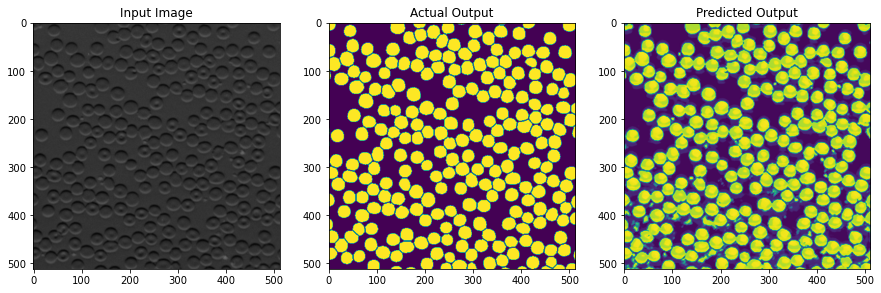

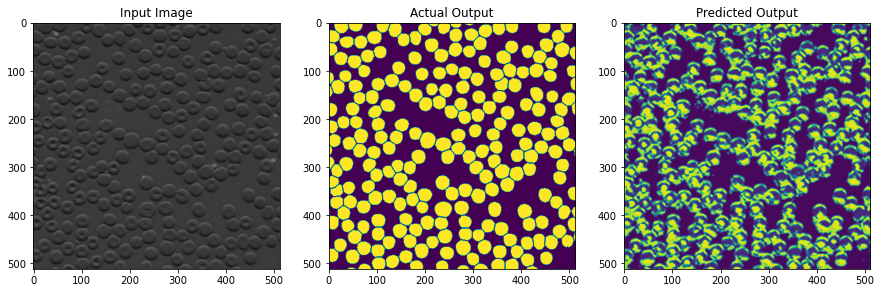

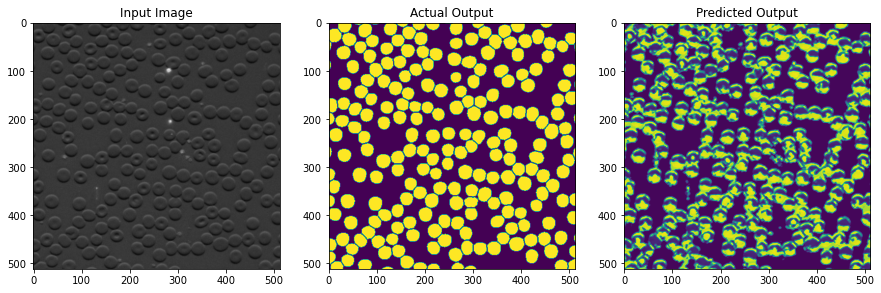

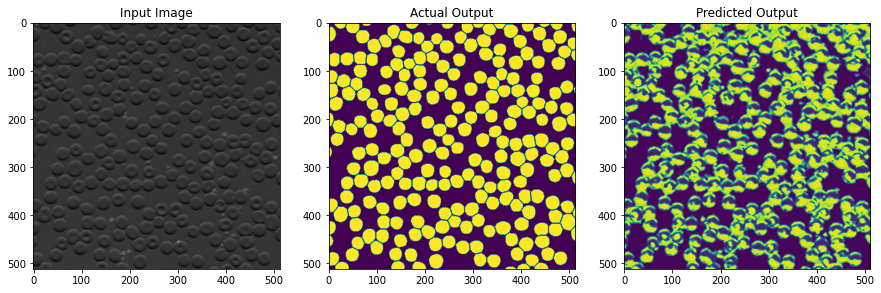

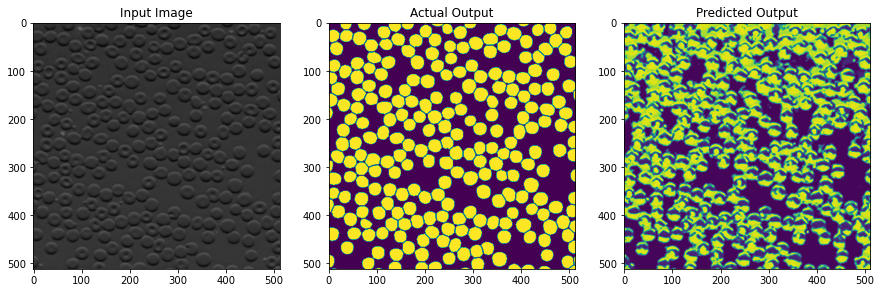

...

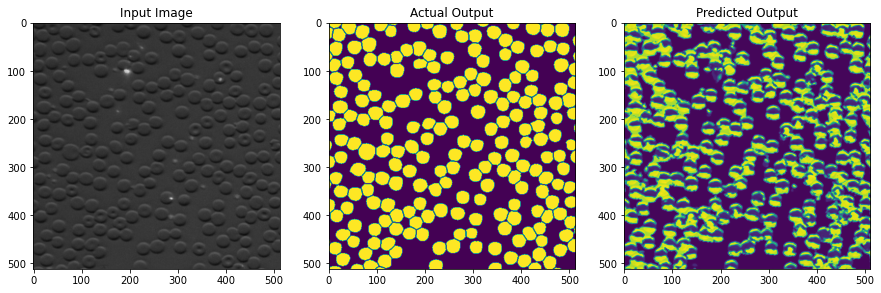

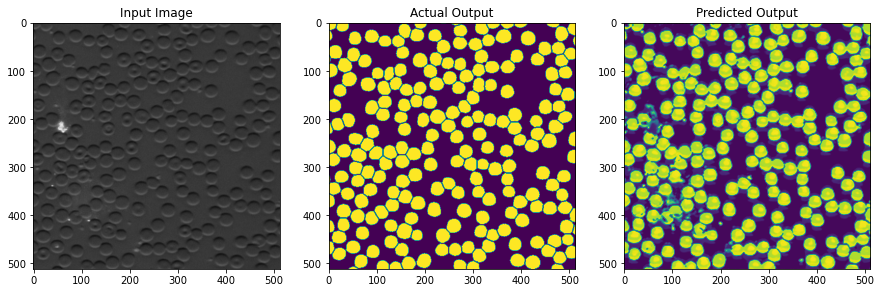

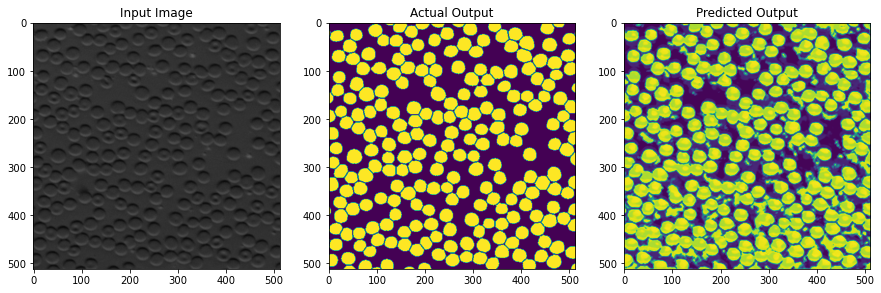

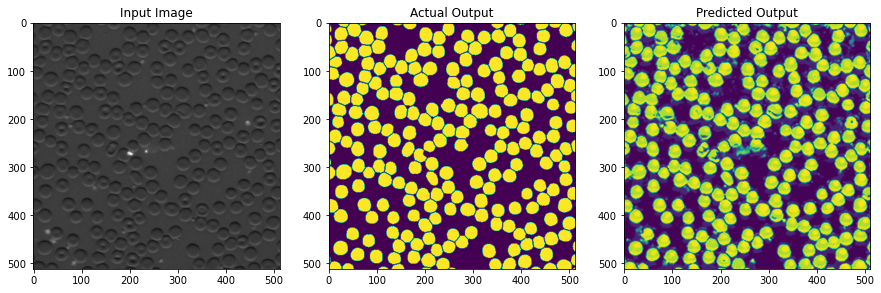

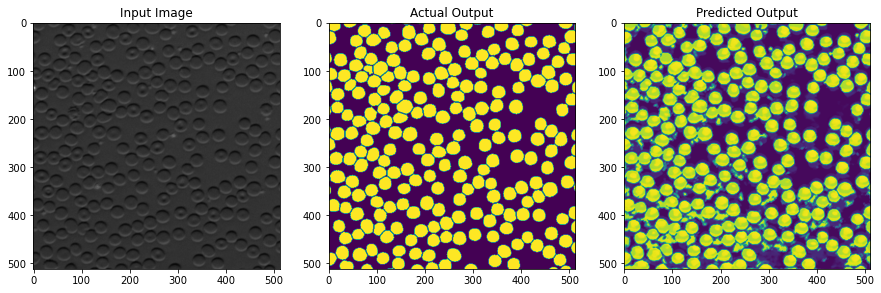

Best acc at epoch 5: 0.8404106044769287
Best acc at epoch 5: 0.8404106044769287
Best acc at epoch 5: 0.8404106044769287
Best acc at epoch 5: 0.8404106044769287


save checkpoint
lr =  0.001


Epoch: [6][   0/1600]	Time  0.238 ( 0.238)	Data  0.168 ( 0.168)	Loss 5.3656e-02 (5.3656e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [6][   0/1600]	Time  0.238 ( 0.238)	Data  0.168 ( 0.168)	Loss 5.3656e-02 (5.3656e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [6][   0/1600]	Time  0.238 ( 0.238)	Data  0.168 ( 0.168)	Loss 5.3656e-02 (5.3656e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [6][   0/1600]	Time  0.238 ( 0.238)	Data  0.168 ( 0.168)	Loss 5.3656e-02 (5.3656e-02)	Acc@1   0.93 (  0.93)	Acc@5   0.93 (  0.93)
Epoch: [6][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.016)	Loss 4.2497e-02 (4.1039e-02)	Acc@1   0.94 (  0.95)	Acc@5   0.94 (  0.95)
Epoch: [6][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.016)	Loss 4.2497e-02 (4.1039e-02)	Acc@1   0.94 (  0.95)	Acc@5   0.94 (  0.95)
Epoch: [6][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.016)	Loss 4.2497e-02 (4.1039e-02)	Acc@1   0.94 (  0.95)	Acc@5   0.94 (  0.95)
Epoch: [6][  10/1600]	Time  0.038 ( 0.060

save checkpoint
lr =  0.001


Epoch: [7][   0/1600]	Time  0.261 ( 0.261)	Data  0.090 ( 0.090)	Loss 3.3751e-02 (3.3751e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [7][   0/1600]	Time  0.261 ( 0.261)	Data  0.090 ( 0.090)	Loss 3.3751e-02 (3.3751e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [7][   0/1600]	Time  0.261 ( 0.261)	Data  0.090 ( 0.090)	Loss 3.3751e-02 (3.3751e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [7][   0/1600]	Time  0.261 ( 0.261)	Data  0.090 ( 0.090)	Loss 3.3751e-02 (3.3751e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [7][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.009)	Loss 2.9290e-02 (4.1075e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [7][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.009)	Loss 2.9290e-02 (4.1075e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [7][  10/1600]	Time  0.038 ( 0.060)	Data  0.000 ( 0.009)	Loss 2.9290e-02 (4.1075e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [7][  10/1600]	Time  0.038 ( 0.060

save checkpoint
lr =  0.001


Epoch: [8][   0/1600]	Time  0.259 ( 0.259)	Data  0.090 ( 0.090)	Loss 4.2157e-02 (4.2157e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [8][   0/1600]	Time  0.259 ( 0.259)	Data  0.090 ( 0.090)	Loss 4.2157e-02 (4.2157e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [8][   0/1600]	Time  0.259 ( 0.259)	Data  0.090 ( 0.090)	Loss 4.2157e-02 (4.2157e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [8][   0/1600]	Time  0.259 ( 0.259)	Data  0.090 ( 0.090)	Loss 4.2157e-02 (4.2157e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [8][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 5.8099e-02 (4.1773e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [8][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 5.8099e-02 (4.1773e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [8][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 5.8099e-02 (4.1773e-02)	Acc@1   0.93 (  0.95)	Acc@5   0.93 (  0.95)
Epoch: [8][  10/1600]	Time  0.038 ( 0.061

save checkpoint
lr =  0.001


Epoch: [9][   0/1600]	Time  0.233 ( 0.233)	Data  0.167 ( 0.167)	Loss 4.3788e-02 (4.3788e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [9][   0/1600]	Time  0.233 ( 0.233)	Data  0.167 ( 0.167)	Loss 4.3788e-02 (4.3788e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [9][   0/1600]	Time  0.233 ( 0.233)	Data  0.167 ( 0.167)	Loss 4.3788e-02 (4.3788e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [9][   0/1600]	Time  0.233 ( 0.233)	Data  0.167 ( 0.167)	Loss 4.3788e-02 (4.3788e-02)	Acc@1   0.94 (  0.94)	Acc@5   0.94 (  0.94)
Epoch: [9][  10/1600]	Time  0.040 ( 0.059)	Data  0.000 ( 0.016)	Loss 2.7368e-02 (3.8422e-02)	Acc@1   0.97 (  0.95)	Acc@5   0.97 (  0.95)
Epoch: [9][  10/1600]	Time  0.040 ( 0.059)	Data  0.000 ( 0.016)	Loss 2.7368e-02 (3.8422e-02)	Acc@1   0.97 (  0.95)	Acc@5   0.97 (  0.95)
Epoch: [9][  10/1600]	Time  0.040 ( 0.059)	Data  0.000 ( 0.016)	Loss 2.7368e-02 (3.8422e-02)	Acc@1   0.97 (  0.95)	Acc@5   0.97 (  0.95)
Epoch: [9][  10/1600]	Time  0.040 ( 0.059

save checkpoint
lr =  0.001


Epoch: [10][   0/1600]	Time  0.254 ( 0.254)	Data  0.088 ( 0.088)	Loss 2.8704e-02 (2.8704e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [10][   0/1600]	Time  0.254 ( 0.254)	Data  0.088 ( 0.088)	Loss 2.8704e-02 (2.8704e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [10][   0/1600]	Time  0.254 ( 0.254)	Data  0.088 ( 0.088)	Loss 2.8704e-02 (2.8704e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [10][   0/1600]	Time  0.254 ( 0.254)	Data  0.088 ( 0.088)	Loss 2.8704e-02 (2.8704e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [10][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 2.9201e-02 (3.7027e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [10][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 2.9201e-02 (3.7027e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [10][  10/1600]	Time  0.038 ( 0.061)	Data  0.000 ( 0.009)	Loss 2.9201e-02 (3.7027e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [10][  10/1600]	Time  0.038

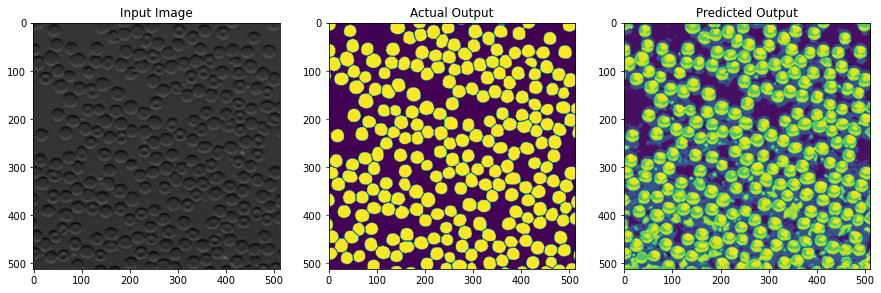

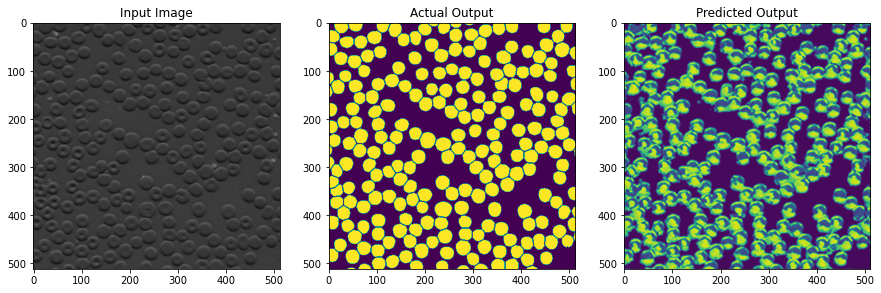

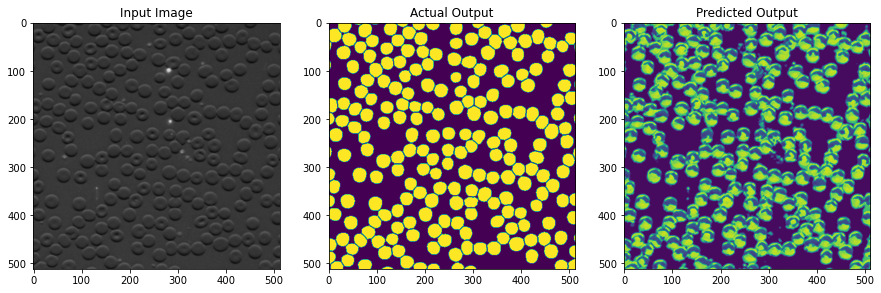

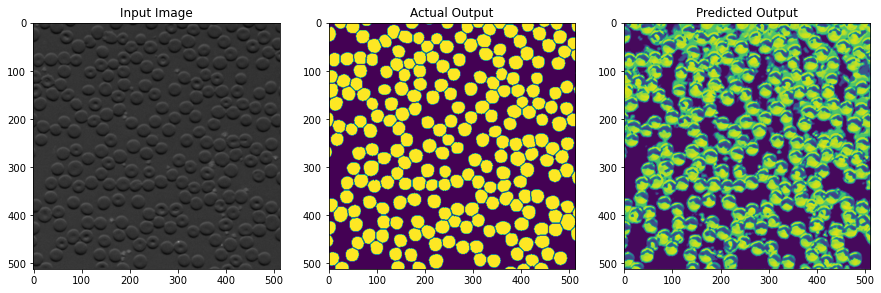

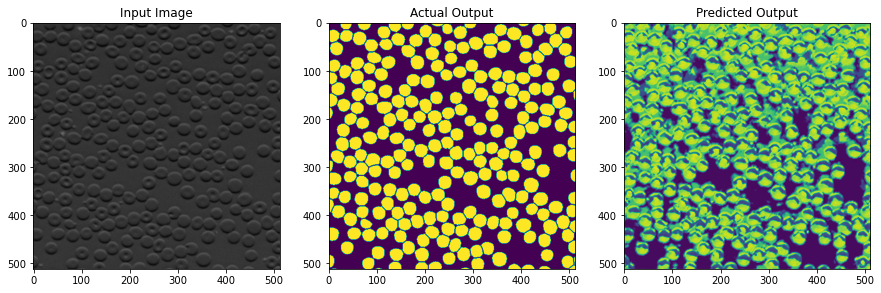

...

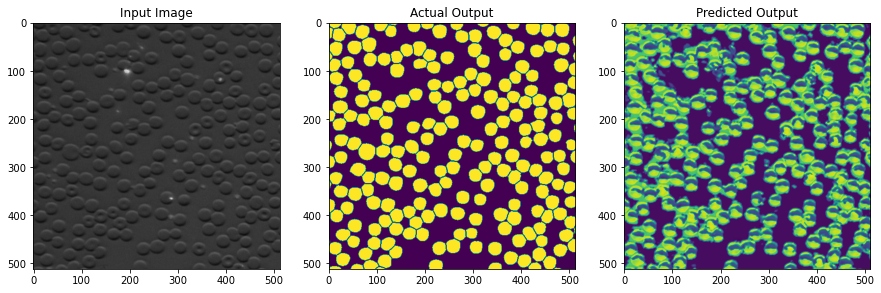

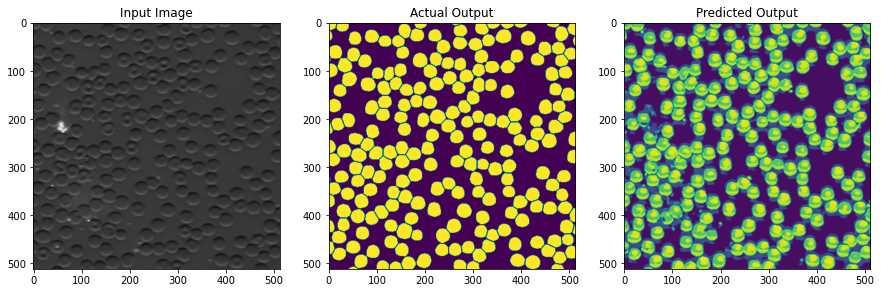

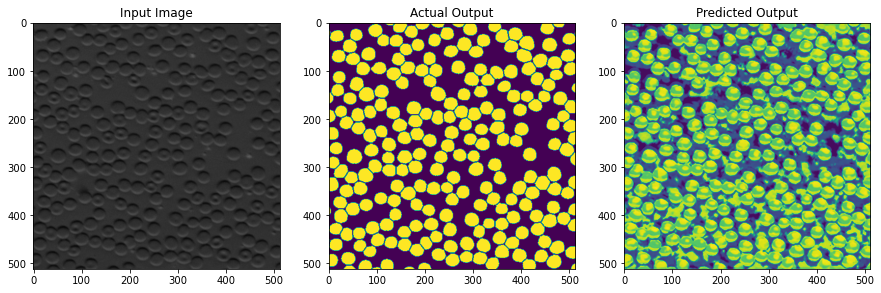

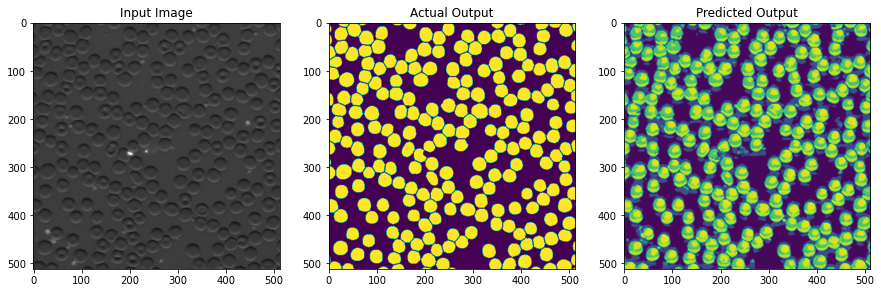

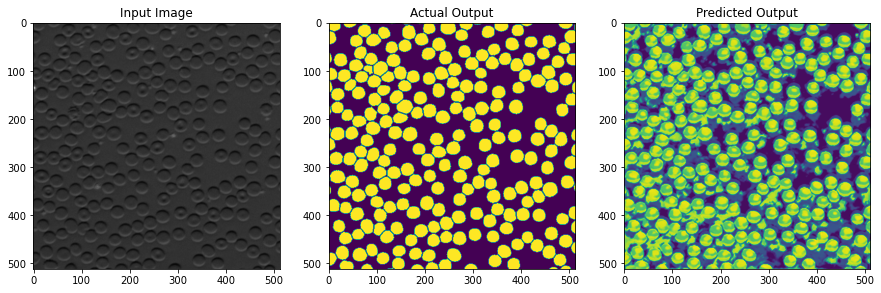

Best acc at epoch 10: 0.866623945236206
Best acc at epoch 10: 0.866623945236206
Best acc at epoch 10: 0.866623945236206
Best acc at epoch 10: 0.866623945236206


save checkpoint
lr =  0.001


Epoch: [11][   0/1600]	Time  0.165 ( 0.165)	Data  0.091 ( 0.091)	Loss 2.4077e-02 (2.4077e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [11][   0/1600]	Time  0.165 ( 0.165)	Data  0.091 ( 0.091)	Loss 2.4077e-02 (2.4077e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [11][   0/1600]	Time  0.165 ( 0.165)	Data  0.091 ( 0.091)	Loss 2.4077e-02 (2.4077e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [11][   0/1600]	Time  0.165 ( 0.165)	Data  0.091 ( 0.091)	Loss 2.4077e-02 (2.4077e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [11][  10/1600]	Time  0.038 ( 0.053)	Data  0.000 ( 0.009)	Loss 3.0796e-02 (3.1393e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [11][  10/1600]	Time  0.038 ( 0.053)	Data  0.000 ( 0.009)	Loss 3.0796e-02 (3.1393e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [11][  10/1600]	Time  0.038 ( 0.053)	Data  0.000 ( 0.009)	Loss 3.0796e-02 (3.1393e-02)	Acc@1   0.96 (  0.96)	Acc@5   0.96 (  0.96)
Epoch: [11][  10/1600]	Time  0.038

save checkpoint
lr =  0.001


Epoch: [12][   0/1600]	Time  0.162 ( 0.162)	Data  0.093 ( 0.093)	Loss 3.4414e-02 (3.4414e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [12][   0/1600]	Time  0.162 ( 0.162)	Data  0.093 ( 0.093)	Loss 3.4414e-02 (3.4414e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [12][   0/1600]	Time  0.162 ( 0.162)	Data  0.093 ( 0.093)	Loss 3.4414e-02 (3.4414e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [12][   0/1600]	Time  0.162 ( 0.162)	Data  0.093 ( 0.093)	Loss 3.4414e-02 (3.4414e-02)	Acc@1   0.95 (  0.95)	Acc@5   0.95 (  0.95)
Epoch: [12][  10/1600]	Time  0.037 ( 0.052)	Data  0.000 ( 0.009)	Loss 3.4398e-02 (3.7548e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [12][  10/1600]	Time  0.037 ( 0.052)	Data  0.000 ( 0.009)	Loss 3.4398e-02 (3.7548e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [12][  10/1600]	Time  0.037 ( 0.052)	Data  0.000 ( 0.009)	Loss 3.4398e-02 (3.7548e-02)	Acc@1   0.96 (  0.95)	Acc@5   0.96 (  0.95)
Epoch: [12][  10/1600]	Time  0.037

save checkpoint
lr =  0.001


Epoch: [13][   0/1600]	Time  0.158 ( 0.158)	Data  0.090 ( 0.090)	Loss 2.5532e-02 (2.5532e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [13][   0/1600]	Time  0.158 ( 0.158)	Data  0.090 ( 0.090)	Loss 2.5532e-02 (2.5532e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [13][   0/1600]	Time  0.158 ( 0.158)	Data  0.090 ( 0.090)	Loss 2.5532e-02 (2.5532e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [13][   0/1600]	Time  0.158 ( 0.158)	Data  0.090 ( 0.090)	Loss 2.5532e-02 (2.5532e-02)	Acc@1   0.97 (  0.97)	Acc@5   0.97 (  0.97)
Epoch: [13][  10/1600]	Time  0.040 ( 0.052)	Data  0.000 ( 0.009)	Loss 4.6879e-02 (3.1901e-02)	Acc@1   0.94 (  0.96)	Acc@5   0.94 (  0.96)
Epoch: [13][  10/1600]	Time  0.040 ( 0.052)	Data  0.000 ( 0.009)	Loss 4.6879e-02 (3.1901e-02)	Acc@1   0.94 (  0.96)	Acc@5   0.94 (  0.96)
Epoch: [13][  10/1600]	Time  0.040 ( 0.052)	Data  0.000 ( 0.009)	Loss 4.6879e-02 (3.1901e-02)	Acc@1   0.94 (  0.96)	Acc@5   0.94 (  0.96)
Epoch: [13][  10/1600]	Time  0.040

In [ ]:
if __name__ == '__main__':
    main()


cuda:0
tensor([[[[-2.8241, -3.0036, -2.5096,  ...,  0.2771,  0.6504,  0.5400],
          [-1.5906, -6.5715, -4.3651,  ...,  0.9404,  0.5562,  0.5400],
          [-4.0962, -2.0390,  7.2344,  ...,  3.6359,  1.5448,  0.5400],
          ...,
          [-4.6205,  5.3227, -2.5487,  ..., -2.1601, -2.3000, -2.8862],
          [-4.1330,  4.2045, -2.5487,  ..., -2.7401, -2.1328, -1.9231],
          [-4.6140,  4.3196, -2.3771,  ...,  0.9301, -0.1691, -0.0212]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


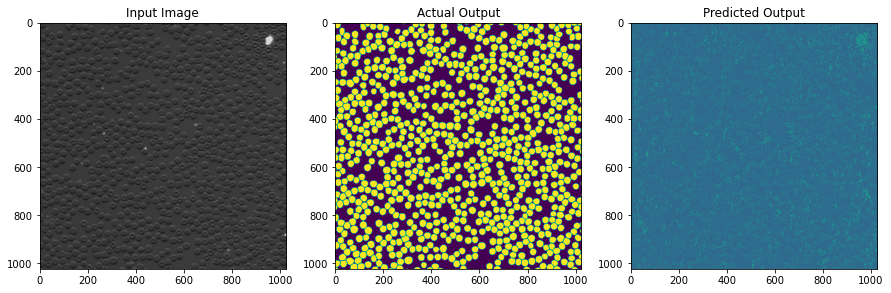

0.5234565734863281
tensor([[[[-1.7231e+00, -1.2845e+00,  1.1148e+00,  ..., -1.6487e+00,
            5.1748e+00,  5.4416e-01],
          [-1.5241e+00, -4.2538e+00, -2.0164e+00,  ...,  3.2316e+00,
            1.2638e+01,  5.4416e-01],
          [-4.0176e+00, -1.7791e+00,  8.7217e+00,  ...,  5.7118e+00,
            1.1364e+01,  5.4416e-01],
          ...,
          [-4.4791e+00,  2.8404e+00,  1.2577e+01,  ...,  2.8252e+00,
            5.4435e+00,  1.2918e-02],
          [-3.7604e+00,  3.6588e+00,  1.7251e+01,  ...,  1.6039e+00,
            2.7704e+00, -2.4464e-01],
          [-4.2147e+00,  1.5059e+01,  2.1045e+01,  ...,  1.4518e+00,
           -2.4194e+00, -2.0835e+00]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


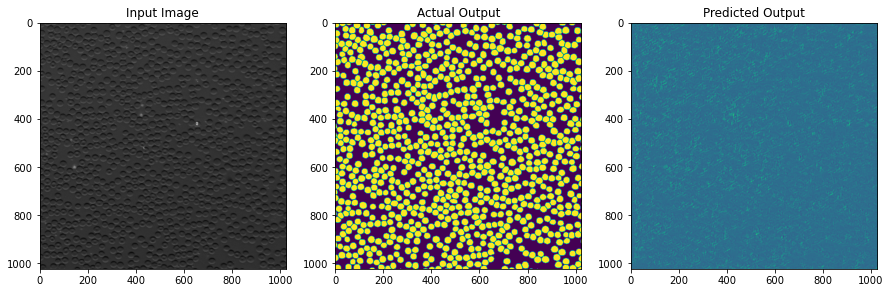

0.5206546783447266
tensor([[[[-2.4811, -2.3646, -2.5392,  ..., -1.9951, -1.3976, -3.2670],
          [-2.3354, -6.8190, -3.4472,  ..., -1.9919, -0.0160, -6.0557],
          [-4.9672, -2.8981,  8.4554,  ..., -3.9778, -2.3577, -2.4822],
          ...,
          [-4.8290,  1.6246, 10.7594,  ..., -3.3416, -1.0367, -0.9442],
          [-4.1031,  0.0428, 15.0153,  ..., -1.1504, -0.8112, -0.2141],
          [-4.3981, 12.4162, 14.6745,  ...,  2.7389,  1.4779,  0.2085]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


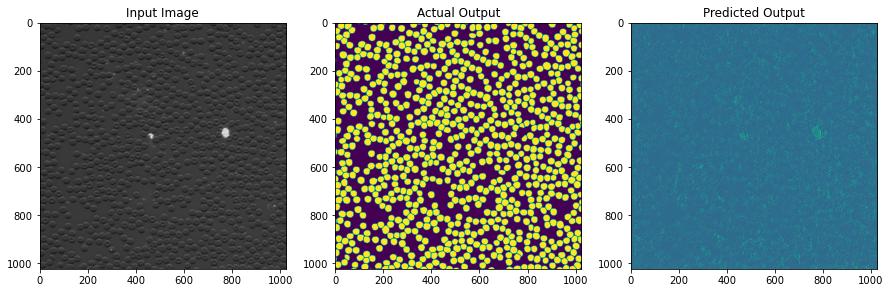

0.5510520935058594
tensor([[[[-1.5341, -1.4359, -1.3712,  ..., -0.6282,  0.7966, -0.5568],
          [-1.5341, -3.6242, -1.0209,  ...,  0.4728,  0.6014,  0.5328],
          [-3.8812,  2.4423, 11.1343,  ...,  0.0213,  0.2108,  0.5439],
          ...,
          [-3.0070, -1.8578, -1.6394,  ..., -1.0313,  1.5812,  1.1400],
          [-3.1128, -2.2937, -2.8514,  ...,  0.1455,  2.2246,  1.9341],
          [-4.4994, 15.1639, 15.8625,  ...,  1.2208,  2.1888,  1.0692]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


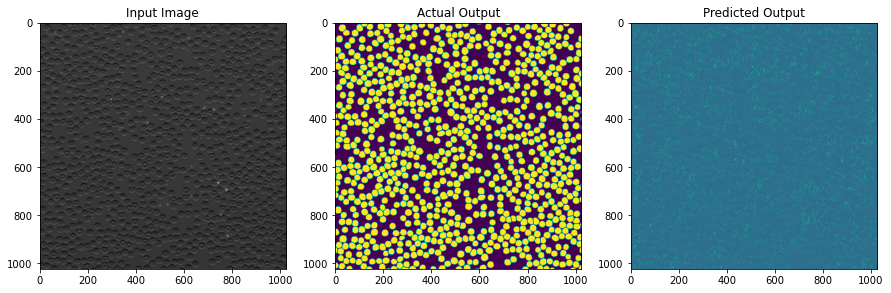

0.5394954681396484
tensor([[[[-2.2796e+00, -3.4432e+00, -3.3040e+00,  ..., -1.1308e+00,
            6.6811e-01,  5.6035e-01],
          [-3.7178e+00, -5.3667e+00, -3.3663e+00,  ..., -2.4829e+00,
            7.1612e-02,  5.6035e-01],
          [-5.5888e+00, -1.9061e+00, -1.9136e+00,  ..., -2.1112e+00,
           -7.7731e-02,  5.6035e-01],
          ...,
          [-3.8821e+00,  6.3142e+00,  9.1140e+00,  ..., -1.5879e-01,
            9.4029e-01,  2.4294e-03],
          [-3.5326e+00,  5.6030e+00,  1.2259e+01,  ...,  9.8070e-01,
            1.3681e+00, -4.3590e-01],
          [-4.2725e+00,  1.4182e+01,  1.5073e+01,  ...,  1.2718e+00,
            7.4902e-01,  7.0871e-01]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


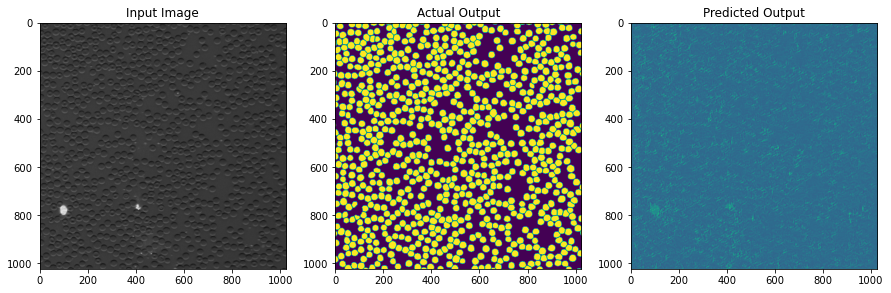

0.5389604568481445
tensor([[[[-2.9824e+00, -1.9335e+00, -2.7453e+00,  ...,  5.4890e-01,
            1.2151e-01, -2.9327e+00],
          [-2.5441e+00, -5.4326e+00, -3.9088e+00,  ...,  5.4890e-01,
            5.4890e-01, -3.3317e+00],
          [-5.6181e+00, -1.4804e+00,  3.2945e+00,  ...,  8.7269e-01,
            5.4890e-01,  5.4890e-01],
          ...,
          [-3.8177e+00,  4.3067e+00,  1.5511e+01,  ..., -4.7391e+00,
            1.2310e+00,  6.8175e-01],
          [-3.6491e+00,  5.3040e+00,  1.8228e+01,  ..., -4.0187e+00,
            2.6912e-03,  2.7484e-01],
          [-4.4310e+00,  1.4267e+01,  1.8452e+01,  ..., -1.7143e+00,
           -5.8613e-01,  5.3358e-01]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


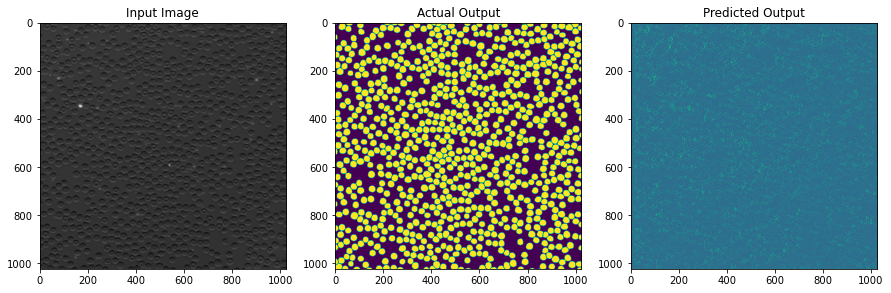

0.548304557800293
tensor([[[[-3.8474, -3.0658, -3.4090,  ...,  2.1224,  0.5205,  0.5205],
          [-3.3591, -5.8127, -1.1196,  ...,  5.0781,  0.5205,  0.9449],
          [-4.4679, -3.9818,  4.0411,  ...,  5.5191,  0.5205,  1.8228],
          ...,
          [-1.9198,  1.3686,  8.9446,  ..., -0.9676,  1.1908,  0.8126],
          [-2.2108,  0.4385,  6.9341,  ...,  0.1229,  1.9110,  1.5072],
          [-4.3312,  6.9843,  3.9107,  ...,  2.0689,  3.5179,  1.6526]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


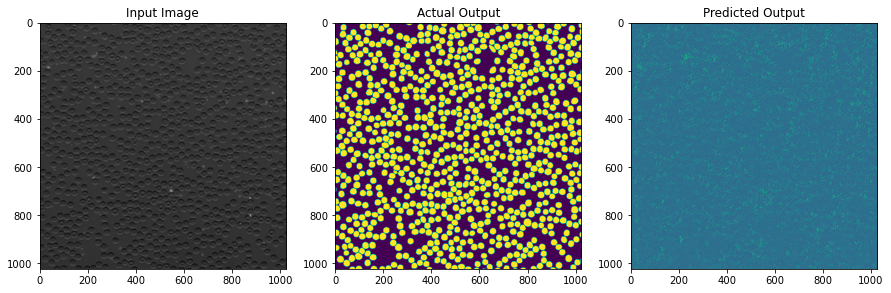

0.5635738372802734
tensor([[[[-1.7184, -1.5447,  1.4511,  ...,  0.7115,  0.5527,  0.2644],
          [-1.5447, -4.2427,  2.6631,  ...,  0.3157,  0.7764,  1.3370],
          [-4.7314,  0.3103,  9.0817,  ...,  0.1961,  0.7338,  2.5714],
          ...,
          [-3.6750, 10.5925,  7.8901,  ..., -2.2993, -2.4777, -0.6459],
          [-3.6470,  9.1541, 10.4222,  ..., -3.2260, -2.8464,  0.2707],
          [-4.4363, 15.9225, 13.0522,  ..., -0.5366, -0.8852, -0.7698]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


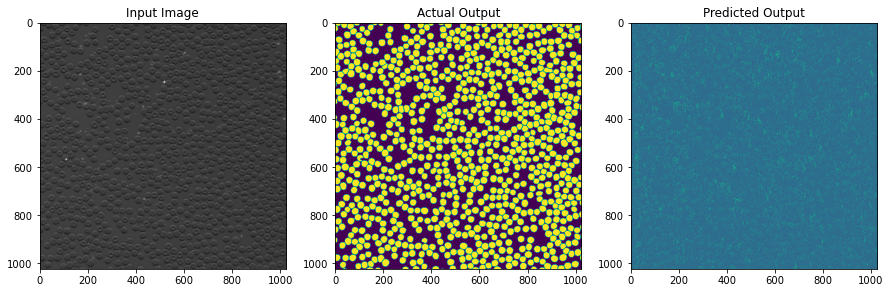

0.5194711685180664
tensor([[[[-1.8255, -2.6568, -2.9715,  ...,  0.4951,  0.5461,  0.5461],
          [-2.2304, -7.9633, -5.4649,  ..., -1.7730, -1.5137, -1.5137],
          [-4.5259, -4.4429,  6.5272,  ..., -1.5805, -1.5137, -1.5137],
          ...,
          [-3.6179,  5.8899,  7.1119,  ..., -1.8469, -0.3031,  0.5745],
          [-3.6179,  4.4370, 10.8744,  ..., -1.8381,  0.0507,  1.0091],
          [-4.3545, 14.0405, 16.0137,  ...,  2.1032,  1.8843,  0.8710]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


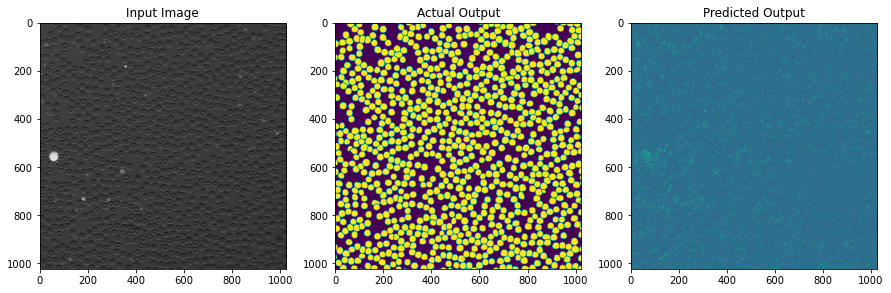

0.5111246109008789
tensor([[[[-2.1331, -1.6791, -2.2944,  ..., -0.2863,  0.4953,  0.4795],
          [-1.5972, -4.7740, -1.9243,  ...,  0.5052,  0.1721,  0.4795],
          [-5.1233,  2.4015,  8.4657,  ...,  3.2680,  0.4069,  0.4795],
          ...,
          [-4.2053, -3.8111, -1.5393,  ...,  1.7761, -2.3794, -2.2800],
          [-3.6808, -3.6332, -1.5385,  ...,  1.0539, -4.2381, -3.4060],
          [-4.7170,  5.2695,  7.2595,  ...,  0.9544, -2.7954, -2.9142]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


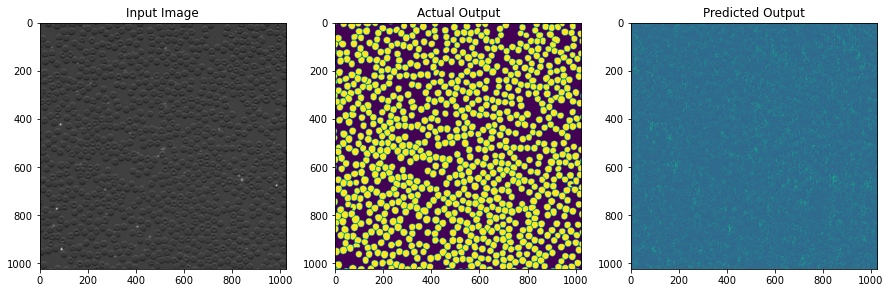

0.5116996765136719
tensor([[[[-1.7855, -1.6418, -1.1032,  ..., -1.7923,  0.5239,  0.5836],
          [-1.4892, -3.1689, -1.0540,  ..., -3.4745, -0.2281,  0.4119],
          [-4.2637,  1.3510, 10.5501,  ..., -3.9954, -0.3514,  0.4273],
          ...,
          [-4.2302, -1.4385, 13.4569,  ..., -3.7508,  0.1368,  0.6331],
          [-4.2048,  2.1422, 18.2903,  ..., -2.4393,  0.9910,  0.7078],
          [-4.3061, 16.0269, 20.4057,  ...,  0.3540,  1.3993,  0.4944]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


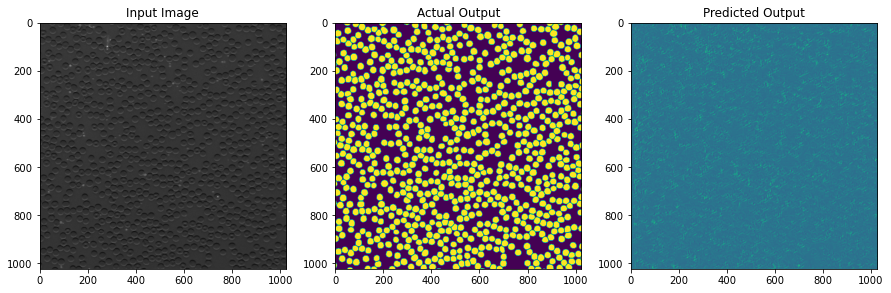

0.5639371871948242
tensor([[[[-1.9149, -2.4783, -1.0251,  ...,  0.4732,  0.5036,  0.5036],
          [-1.5163, -5.0450, -5.9628,  ...,  0.4289,  0.5036,  0.5036],
          [-4.1842, -3.6768,  6.6725,  ...,  0.9717,  0.5036,  0.5036],
          ...,
          [-3.8501,  7.6456, 10.1837,  ..., -3.6331, -0.4992,  0.3728],
          [-3.5766,  7.1175, 14.7738,  ..., -2.1535, -4.1080,  0.2221],
          [-4.0951, 16.1717, 18.3602,  ..., -1.5997, -3.5999, -1.1854]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


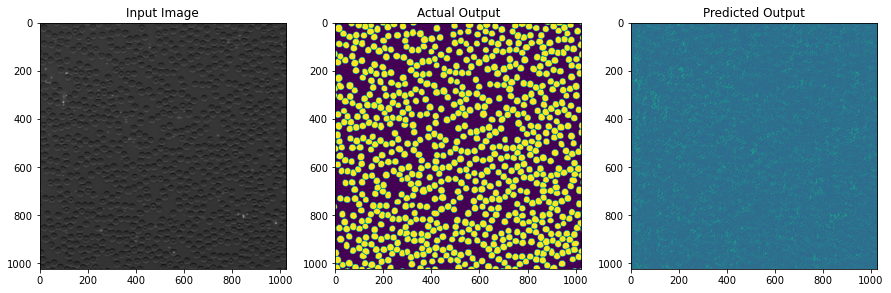

0.5647220611572266
tensor([[[[-1.6557e+00, -1.4943e+00, -1.4943e+00,  ...,  1.1487e+00,
            5.3336e-01,  5.3336e-01],
          [-1.4943e+00, -4.3877e+00, -1.9905e-01,  ...,  2.0220e+00,
            5.3336e-01,  5.9956e-01],
          [-4.1502e+00, -1.3367e+00,  1.2014e+01,  ...,  3.6763e+00,
            7.0844e-01,  9.7944e-01],
          ...,
          [-4.0304e+00,  5.4892e+00,  3.9564e+00,  ...,  1.2082e+00,
            9.2839e-01,  5.3336e-01],
          [-3.5163e+00,  4.5736e+00,  1.1003e+01,  ...,  6.2588e-01,
            1.5556e+00,  9.8404e-03],
          [-3.9537e+00,  1.6335e+01,  1.9247e+01,  ..., -1.4356e+00,
            1.0539e+00,  6.8178e-01]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


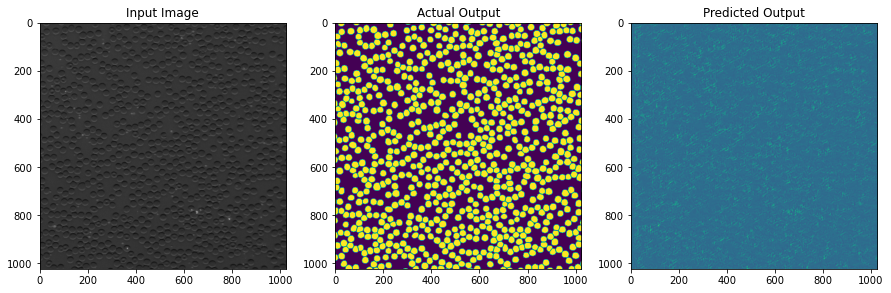

0.5632352828979492
tensor([[[[-1.5411, -0.8488,  0.0834,  ...,  0.5692,  0.6420,  0.5521],
          [-1.4940, -4.5840, -3.9710,  ...,  1.1608,  0.6930,  0.5521],
          [-4.4234,  0.3786,  6.8362,  ...,  3.5390,  0.6562,  0.5521],
          ...,
          [-3.5463,  9.7929, 15.2047,  ..., -2.5444,  1.7774,  1.3934],
          [-3.5463,  8.7658, 13.0176,  ..., -0.0255,  4.0319,  2.7653],
          [-4.4348, 11.0517,  9.7329,  ...,  3.9661,  4.1488,  2.4063]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


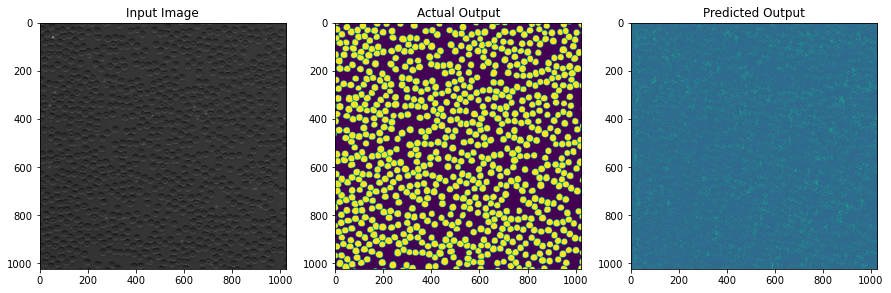

0.5564489364624023
tensor([[[[-3.9828e+00, -3.4966e+00, -3.6917e+00,  ..., -1.7247e+00,
            4.8030e-03, -1.4602e+00],
          [-3.5527e+00, -5.5973e+00, -2.0934e+00,  ..., -1.8802e+00,
            2.5935e-01,  5.0043e-01],
          [-5.6295e+00,  3.4861e-01,  1.0639e+00,  ..., -1.7284e+00,
            2.1744e-01,  5.3027e-01],
          ...,
          [-4.6786e+00,  1.2259e+01,  5.8673e+00,  ..., -3.7042e+00,
            2.3854e+00,  2.4818e-01],
          [-4.6786e+00,  6.8307e+00,  2.6778e+00,  ..., -3.7397e+00,
            1.3851e+00, -1.4960e-02],
          [-5.3167e+00,  3.7643e+00,  2.4793e+00,  ...,  1.9614e+00,
            1.1701e+01,  3.0026e+00]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


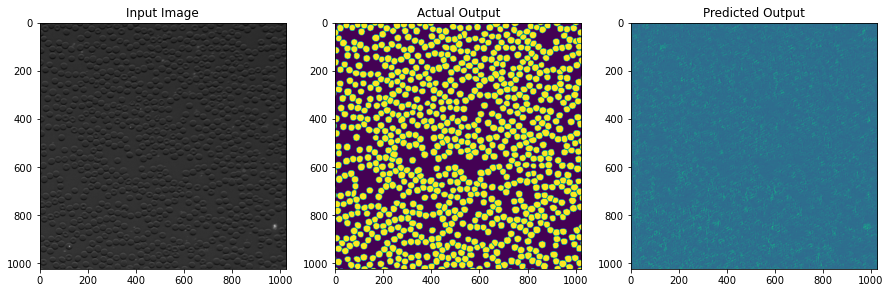

0.5525732040405273
tensor([[[[-1.5240, -1.6336,  1.2194,  ...,  0.6354,  0.6342,  2.2505],
          [-1.5240, -3.2996,  1.5610,  ...,  1.1547,  2.8924,  2.3527],
          [-2.6762,  2.1684,  6.8282,  ...,  3.3695,  2.6732,  0.6342],
          ...,
          [-3.8061,  9.7840, 17.1147,  ..., -3.7797,  2.5670, -1.0269],
          [-3.0288,  3.0620, 16.0232,  ..., -3.3750,  4.7959,  0.6966],
          [-4.2048, 18.2207, 22.0491,  ..., -1.1006,  5.4643,  1.1311]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


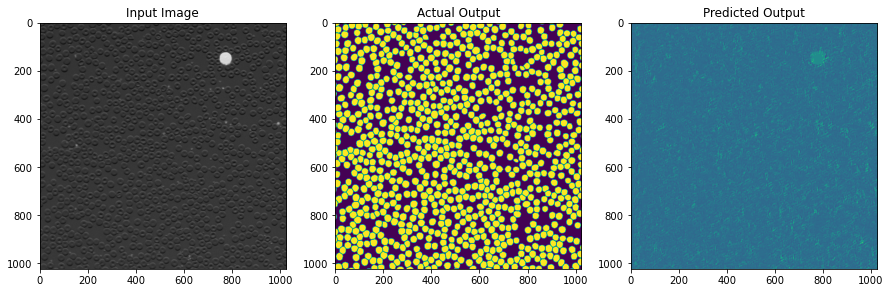

0.48540782928466797
tensor([[[[-4.4282, -3.1425, -3.4550,  ...,  0.5617,  0.5617,  1.7790],
          [-4.7836, -6.5250, -2.0895,  ...,  1.7847,  3.0080,  2.8873],
          [-5.7338, -1.9272,  2.4670,  ...,  1.5142,  2.0541,  1.5562],
          ...,
          [-4.2558, -4.6544, -2.0752,  ..., -2.9118,  7.5407, -0.0117],
          [-4.1296, -4.1529, -3.8935,  ..., -9.3175,  2.5741, -2.4137],
          [-4.6541,  7.9179,  7.5981,  ..., -4.8074,  0.7183, -1.5301]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


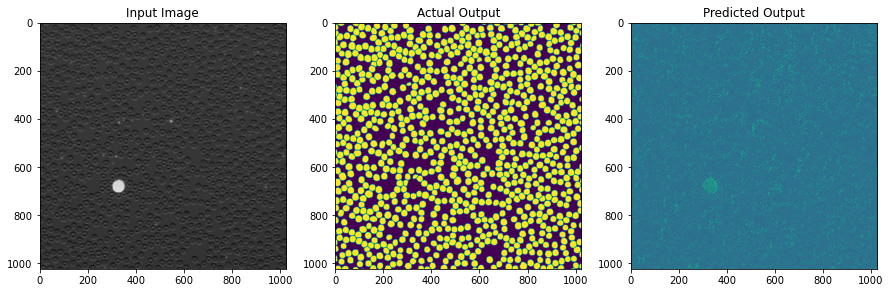

0.5105161666870117
tensor([[[[-1.8433, -1.5488,  1.7148,  ..., -1.1875,  0.7111,  0.5482],
          [-1.5488, -4.5114, -0.6269,  ..., -1.9867,  0.0474,  0.5482],
          [-4.1650, -2.0709, 10.9896,  ..., -1.5077, -0.0371,  0.5482],
          ...,
          [-4.7285,  0.9145,  8.9957,  ..., -2.2659, -2.6632, -0.7264],
          [-4.0810,  0.0529, 16.2767,  ..., -2.7341, -1.9993,  0.5482],
          [-3.9928, 16.8921, 22.9807,  ..., -1.7234,  0.5482,  0.5482]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


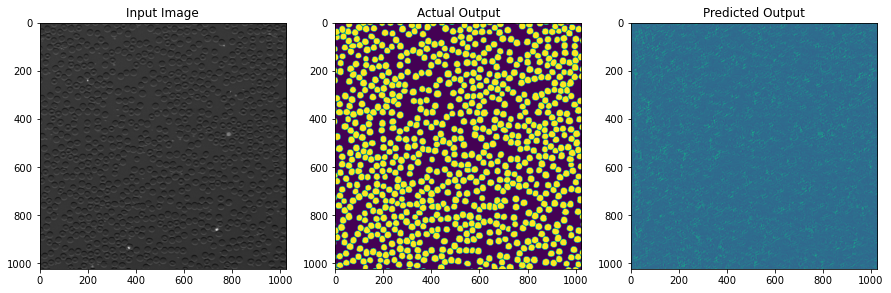

0.5528287887573242
tensor([[[[-1.8377, -1.5097, -1.5097,  ..., -1.7712,  2.7708,  0.5667],
          [-1.5097, -4.4381, -1.6786,  ...,  4.5358,  7.9315,  2.8194],
          [-4.7548, -3.7557,  5.0687,  ...,  6.5088,  7.8055,  2.5176],
          ...,
          [-4.1994,  7.1877,  9.5304,  ...,  6.7480,  7.5629,  0.5628],
          [-3.6777,  6.6085, 13.5356,  ...,  6.4147,  5.3777,  0.6036],
          [-4.3483, 15.7749, 18.1290,  ...,  2.7781,  0.9371, -1.6587]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


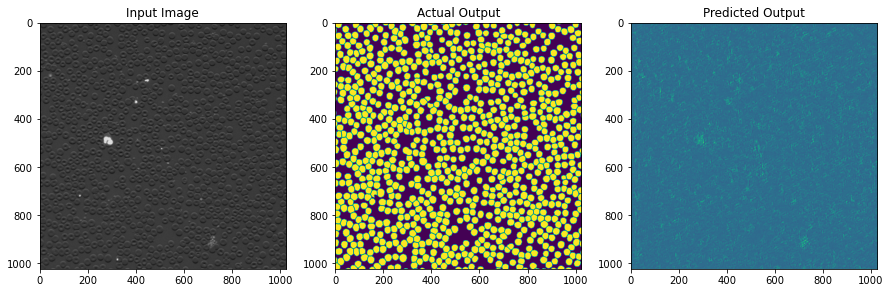

0.48587512969970703
tensor([[[[-3.6102e+00, -3.4156e+00, -3.1442e+00,  ...,  5.6143e-01,
            5.6143e-01,  8.4810e-01],
          [-5.7395e+00, -2.1543e+00, -2.5366e+00,  ...,  1.1831e+00,
            2.4269e+00,  1.1947e+00],
          [-5.7395e+00,  4.9564e-01, -2.5366e+00,  ...,  1.6350e+00,
            1.7453e+00,  1.0655e+00],
          ...,
          [-4.6659e+00, -4.6659e+00,  3.0665e+00,  ..., -3.3490e+00,
            1.2634e+00,  1.6547e+00],
          [-4.4000e+00, -3.8909e+00,  3.5131e+00,  ..., -3.6360e+00,
            4.5407e-01,  5.6143e-01],
          [-4.7641e+00,  1.3611e+01,  1.4548e+01,  ..., -5.4418e+00,
           -1.0651e-02,  5.6143e-01]]]], device='cuda:0',
       grad_fn=<ConvolutionBackward0>)


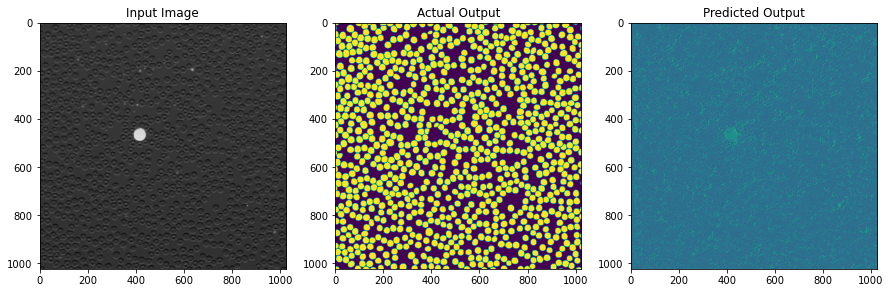

0.5177402496337891
tensor([[[[-3.9030, -3.5124, -0.9410,  ...,  0.4769,  0.5119, -0.2566],
          [-2.9277, -4.5679,  1.4258,  ...,  0.4258,  0.5119,  0.5119],
          [-5.6388,  0.1480,  6.9131,  ...,  1.4221,  0.5322,  0.5119],
          ...,
          [-4.4875,  0.7719,  8.9507,  ..., 12.6215,  1.8764,  1.9801],
          [-4.1822,  0.9083, 11.7790,  ..., 14.7801,  1.6411,  1.2610],
          [-4.5567, 11.9728, 15.9328,  ..., 10.1313,  1.0583,  0.5119]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


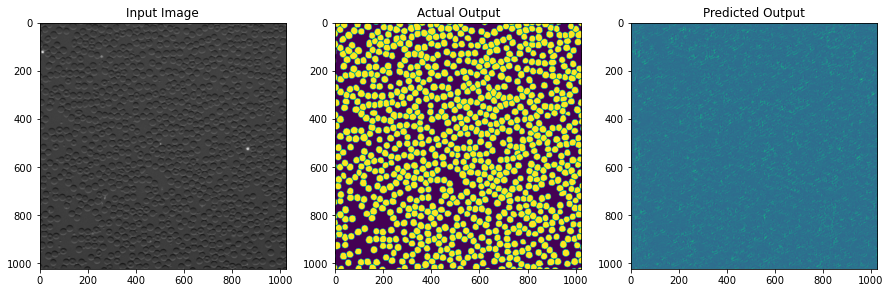

0.5066728591918945
tensor([[[[-2.6646, -2.1832, -1.2572,  ..., -2.6544, -0.6362, -0.8704],
          [-2.5428, -4.3974, -1.0046,  ...,  6.4737,  8.0245,  3.9524],
          [-5.6655, -0.6277,  5.9020,  ...,  5.9136,  4.2162,  2.1966],
          ...,
          [-4.4866, -4.3562,  7.9206,  ..., -0.3120, -1.4993,  0.3354],
          [-3.9696, -4.3330, 13.9754,  ...,  0.5480, -1.2675,  0.3560],
          [-4.3046, 21.7932, 23.7231,  ...,  4.2684,  1.9290,  0.5288]]]],
       device='cuda:0', grad_fn=<ConvolutionBackward0>)


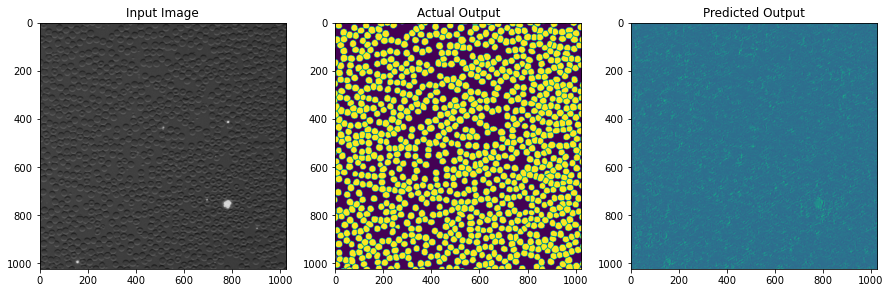

0.4783658981323242


In [45]:
# Plot sample data


val_loader = torch.utils.data.DataLoader(test_dataset,
        batch_size=args.batch_size, shuffle=False,
        num_workers=args.workers, pin_memory=True)

def show(img,output,label,denorm = False):
    img,output,label = img.cpu(),output.cpu(),label.cpu()
    fig,ax = plt.subplots(len(output),3,figsize=(15,30))
    cols = ['Input Image','Actual Output','Predicted Output']
    for i in range(len(output)):
        if(len(output) == 3):
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[i][0].imshow(Img.permute(1,2,0))
            ax[i][2].imshow(Lab)
            ax[i][1].imshow(act.permute(1,2,0))
        else:
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[0].imshow(Img.permute(1,2,0))
            ax[2].imshow(Lab)
            ax[1].imshow(act.permute(1,2,0))
            #ax[0].title('this')
            for ax, col in zip(ax, cols):
                ax.set_title(col)
    plt.show()
    
c = 0
for img,label in (val_loader):
        # img = img.float().to(device)
        # img = img / 256
        # print(label)
        label = label.float().to(device)
        img = img.to(device)
        output = model(img)
        print(output)
        show(img,output,label)
        acc1, acc5 = accuracy(output, label, topk=(1,5))
        print(acc1[0])
        if c>20:
            break
        c+=1
        
        
acc1, acc5 = accuracy(output, label, topk=(1,5))

In [ ]:
torch.cuda.is_available() # Check that CUDA works
torch.cuda.device_count() # Check how many CUDA capable devices you have

# Print device human readable names
print(torch.cuda.get_device_name(0))
torch.cuda.get_device_name(1)
# Add more lines with +1 like get_device_name(3), get_device_name(4) if you have more devices.

In [ ]:
# img1 = torch.randn([1, 1, 512, 512])
img2 = img1*1


print(img1 * img2)

def jaccard_sim(img1, img2):
    n = img1.shape[-1]**2
    a = img1 * img2
    b = img1 + img2 - a
    J = a/b
    J[torch.isnan(J)] = 1
    j = torch.sum(J)/n

    return float(j)

print(jaccard_sim(img1,img2))

In [ ]:
img1 = torch.randn([ 1,1, 512, 512])
print(img1.shape)
threshold = threshold_otsu(img1.cpu().detach().numpy())
print(threshold)
mask1 = (img1 > threshold)*1
print(mask)

img2 = torch.randn([ 1,1, 512, 512])
threshold = threshold_otsu(img2.cpu().detach().numpy())
print(threshold)
mask2 = (img2 > threshold)*1


print(jaccard_sim(mask1,mask2))

In [ ]:
      inputs = sample[0].astype("float32")[None, :sz, :sz, :]
        imageio.imwrite(f"octopi-inputs_{i}.png", inputs[0].astype('uint8'))
        labels = sample[1].astype("float32")[None, :sz, :sz, :] * 255
        imageio.imwrite(f"octopi-labels_{i}.png", labels[0].astype('uint8'))
        results = model.predict(inputs)
        output = np.clip(results[0] * 255, 0, 255)[:, :, 0].astype('uint8')
        imageio.imwrite(f"octopi-pred-prob_{i}.png", output)
        threshold = threshold_otsu(output)
        mask = ((output > threshold) * 255).astype('uint8')
        predict_labels = label(mask)

In [ ]:
for param in model.parameters():
    print(param.data)